<a href="https://colab.research.google.com/github/Ricardojnf33/Rossmann_Store_Sales/blob/main/Rossmann_Store_Sales_Modulo_10_1_Entrega_TCC.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 0.0. IMPORTS

In [1]:
pip install inflection seaborn matplotlib IPython boruta

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
import math
import numpy as np
import pandas as pd
#import random
import pickle
import warnings
import inflection
import seaborn as sns
import xgboost as xgb

from matplotlib            import pyplot as plt
from IPython.core.display  import HTML
from IPython.display       import Image
from scipy                 import stats  as ss
from boruta                import BorutaPy
from random                import sample

from sklearn.preprocessing import RobustScaler, MinMaxScaler, LabelEncoder
from sklearn.ensemble      import RandomForestRegressor
from sklearn.metrics       import mean_absolute_error, mean_squared_error
from sklearn.linear_model  import LinearRegression, Lasso

warnings.filterwarnings( 'ignore' )

## 0.1. Helper Functions

In [3]:
def cross_validation( x_training, kfold, model_name, model, verbose=False ):
    mae_list = []
    mape_list = []
    rmse_list = []
    for k in reversed( range( 1, kfold+1 ) ):
        if verbose:
            print( '\nKFold Number: {}'.format( k ) )
        # "start and end" date for validation
        validation_start_date = x_training['date'].max() - datetime.timedelta( days=k*6*7 )
        validation_end_date = x_training['date'].max() - datetime.timedelta( days=(k-1)*6*7 )

        # filtering dataset
        training = x_training[x_training['date'] < validation_start_date]
        validation = x_training[(x_training['date'] >= validation_start_date) & (x_training['date'] <= validation_end_date ) ]

        # training and validation dataset
        # training
        xtraining = training.drop( ['date', 'sales'], axis=1 )
        ytraining = training['sales']

        # validation
        xvalidation = validation.drop( ['date', 'sales'], axis=1 )
        yvalidation = validation['sales']

        # model
        m = model.fit( xtraining, ytraining )

        # prediction
        yhat = m.predict( xvalidation )

        # performance
        m_result = ml_error( model_name, np.expm1( yvalidation ), np.expm1( yhat ) )

        # store performance of each kfold iteration
        mae_list.append( m_result[ 'MAE' ] )
        mape_list.append( m_result[ 'MAPE' ] )
        rmse_list.append( m_result[ 'RMSE' ] )

    return pd.DataFrame( {'Model Name': model_name,
                        'MAE CV': np.round( np.mean( mae_list ), 2 ).astype( str ) + ' +/- ' + np.round( np.std( mae_list ), 2 ).astype ( str ),
                        'MAPE CV': np.round( np.mean( mape_list ), 2 ).astype( str ) + ' +/- ' + np.round( np.std( mape_list ), 2 ).astype ( str ),
                        'RMSE CV': np.round( np.mean( rmse_list ), 2 ).astype( str ) + ' +/- ' + np.round( np.std( rmse_list ), 2 ).astype ( str ) }, index=[0] )


def mean_percentage_error( y, yhat ):
    return np.mean( ( y - yhat ) / y )

def mean_absolute_percentage_error( y, yhat ):
    return np.mean( np.abs( ( y - yhat ) / y)  )


def ml_error( model_name, y, yhat ):
    mae = mean_absolute_error( y, yhat )
    mape = mean_absolute_percentage_error( y, yhat )
    rmse = np.sqrt( mean_squared_error( y, yhat ) )

    return pd.DataFrame ( { 'Model Name': model_name,
                            'MAE': mae,
                            'MAPE': mape,
                            'RMSE': rmse }, index=[0] ) 

def cramer_v( x, y ) :
    cm = pd.crosstab( x, y ).values    
    n = cm.sum()
    r, k = cm.shape

    chi2 = ss.chi2_contingency( cm )[0]
    chi2corr = max( 0, chi2 - (k-1)*(r-1)/(n-1) ) #Correção do Bias
    
    kcorr = k - (k-1)**2/(n-1)
    rcorr = r - (r-1)**2/(n-1)

    return np.sqrt( (chi2corr/n) / ( min( kcorr-1,rcorr-1 ) ) )



def jupyter_settings():
    %matplotlib inline
    %pylab inline
    
    plt.style.use( 'bmh' )
    plt.rcParams['figure.figsize'] = [25, 12]
    plt.rcParams['font.size'] = 24
    
    display( HTML( '<style>.container { width:100% !important; }</style>') )
    pd.options.display.max_columns = None
    pd.options.display.max_rows = None
    pd.set_option( 'display.expand_frame_repr', False )
    
    sns.set()

In [4]:
jupyter_settings()

Populating the interactive namespace from numpy and matplotlib


In [5]:
!git clone https://github.com/Ricardojnf33/Rossmann_Store_Sales.git

fatal: destination path 'Rossmann_Store_Sales' already exists and is not an empty directory.


## 0.2. Loading data

In [6]:
df_sales_raw = pd.read_csv( '/content/Rossmann_Store_Sales/Dataset/train.csv', low_memory=False )
df_store_raw = pd.read_csv( '/content/Rossmann_Store_Sales/Dataset/store.csv', low_memory=False )

# merge
df_raw = pd.merge( df_sales_raw, df_store_raw, how='left', on='Store' )

# 1.0. PASSO 01 - DESCRICAO DOS DADOS

In [7]:
df1 = df_raw.copy()

## 1.1. Rename Columns

In [8]:
cols_old = ['Store', 'DayOfWeek', 'Date', 'Sales', 'Customers', 'Open', 'Promo', 'StateHoliday', 'SchoolHoliday', 
            'StoreType', 'Assortment', 'CompetitionDistance', 'CompetitionOpenSinceMonth',
            'CompetitionOpenSinceYear', 'Promo2', 'Promo2SinceWeek', 'Promo2SinceYear', 'PromoInterval']

snakecase = lambda x: inflection.underscore( x )

cols_new = list( map( snakecase, cols_old ) )

# rename
df1.columns = cols_new

## 1.2. Data Dimensions

In [9]:
print( 'Number of Rows: {}'.format( df1.shape[0] ) )
print( 'Number of Cols: {}'.format( df1.shape[1] ) )

Number of Rows: 1017209
Number of Cols: 18


## 1.3. Data Types

In [10]:
df1['date'] = pd.to_datetime( df1['date'] )
df1.dtypes

store                                    int64
day_of_week                              int64
date                            datetime64[ns]
sales                                    int64
customers                                int64
open                                     int64
promo                                    int64
state_holiday                           object
school_holiday                           int64
store_type                              object
assortment                              object
competition_distance                   float64
competition_open_since_month           float64
competition_open_since_year            float64
promo2                                   int64
promo2_since_week                      float64
promo2_since_year                      float64
promo_interval                          object
dtype: object

## 1.4. Check NA

In [11]:
df1.isna().sum()

store                                0
day_of_week                          0
date                                 0
sales                                0
customers                            0
open                                 0
promo                                0
state_holiday                        0
school_holiday                       0
store_type                           0
assortment                           0
competition_distance              2642
competition_open_since_month    323348
competition_open_since_year     323348
promo2                               0
promo2_since_week               508031
promo2_since_year               508031
promo_interval                  508031
dtype: int64

## 1.5. Fillout NA

In [12]:
df1.sample()

,store,day_of_week,date,sales,customers,open,promo,state_holiday,school_holiday,store_type,assortment,competition_distance,competition_open_since_month,competition_open_since_year,promo2,promo2_since_week,promo2_since_year,promo_interval
85591,852,6,2015-05-16,2583,331,1,0,0,0,c,a,940.0,4.0,2004.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"


In [13]:
#competition_distance        
df1['competition_distance'] = df1['competition_distance'].apply( lambda x: 200000.0 if math.isnan( x ) else x )

#competition_open_since_month
df1['competition_open_since_month'] = df1.apply( lambda x: x['date'].month if math.isnan( x['competition_open_since_month'] ) else x['competition_open_since_month'], axis=1 )

#competition_open_since_year 
df1['competition_open_since_year'] = df1.apply( lambda x: x['date'].year if math.isnan( x['competition_open_since_year'] ) else x['competition_open_since_year'], axis=1 )

#promo2_since_week           
df1['promo2_since_week'] = df1.apply( lambda x: x['date'].week if math.isnan( x['promo2_since_week'] ) else x['promo2_since_week'], axis=1 )

#promo2_since_year           
df1['promo2_since_year'] = df1.apply( lambda x: x['date'].year if math.isnan( x['promo2_since_year'] ) else x['promo2_since_year'], axis=1 )

#promo_interval              
month_map = {1: 'Jan',  2: 'Fev',  3: 'Mar',  4: 'Apr',  5: 'May',  6: 'Jun',  7: 'Jul',  8: 'Aug',  9: 'Sep',  10: 'Oct', 11: 'Nov', 12: 'Dec'}

df1['promo_interval'].fillna(0, inplace=True )

df1['month_map'] = df1['date'].dt.month.map( month_map )

df1['is_promo'] = df1[['promo_interval', 'month_map']].apply( lambda x: 0 if x['promo_interval'] == 0 else 1 if x['month_map'] in x['promo_interval'].split( ',' ) else 0, axis=1 )


In [14]:
df1.isna().sum()

store                           0
day_of_week                     0
date                            0
sales                           0
customers                       0
open                            0
promo                           0
state_holiday                   0
school_holiday                  0
store_type                      0
assortment                      0
competition_distance            0
competition_open_since_month    0
competition_open_since_year     0
promo2                          0
promo2_since_week               0
promo2_since_year               0
promo_interval                  0
month_map                       0
is_promo                        0
dtype: int64

## 1.6. Change Data Types

In [15]:
# competiton
df1['competition_open_since_month'] = df1['competition_open_since_month'].astype( int )
df1['competition_open_since_year'] = df1['competition_open_since_year'].astype( int )
    
# promo2
df1['promo2_since_week'] = df1['promo2_since_week'].astype( int )
df1['promo2_since_year'] = df1['promo2_since_year'].astype( int )

## 1.7. Descriptive Statistics

In [16]:
num_attributes = df1.select_dtypes( include=['int64', 'float64'] )
cat_attributes = df1.select_dtypes( exclude=['int64', 'float64', 'datetime64[ns]'] )

### 1.7.1. Numerical Atributes

In [17]:
# Central Tendency - mean, meadina 
ct1 = pd.DataFrame( num_attributes.apply( np.mean ) ).T
ct2 = pd.DataFrame( num_attributes.apply( np.median ) ).T

# dispersion - std, min, max, range, skew, kurtosis
d1 = pd.DataFrame( num_attributes.apply( np.std ) ).T 
d2 = pd.DataFrame( num_attributes.apply( min ) ).T 
d3 = pd.DataFrame( num_attributes.apply( max ) ).T 
d4 = pd.DataFrame( num_attributes.apply( lambda x: x.max() - x.min() ) ).T 
d5 = pd.DataFrame( num_attributes.apply( lambda x: x.skew() ) ).T 
d6 = pd.DataFrame( num_attributes.apply( lambda x: x.kurtosis() ) ).T 

# concatenar
m = pd.concat( [d2, d3, d4, ct1, ct2, d1, d5, d6] ).T.reset_index()
m.columns = ['attributes', 'min', 'max', 'range', 'mean', 'median', 'std', 'skew', 'kurtosis']
m

,attributes,min,max,range,mean,median,std,skew,kurtosis
0,store,1.0,1115.0,1114.0,558.429727,558.0,321.908493,-0.000955,-1.200524
1,day_of_week,1.0,7.0,6.0,3.998341,4.0,1.997390,0.001593,-1.246873
2,sales,0.0,41551.0,41551.0,5773.818972,5744.0,3849.924283,0.641460,1.778375
3,customers,0.0,7388.0,7388.0,633.145946,609.0,464.411506,1.598650,7.091773
4,open,0.0,1.0,1.0,0.830107,1.0,0.375539,-1.758045,1.090723
5,promo,0.0,1.0,1.0,0.381515,0.0,0.485758,0.487838,-1.762018
6,school_holiday,0.0,1.0,1.0,0.178647,0.0,0.383056,1.677842,0.815154
7,competition_distance,20.0,200000.0,199980.0,5935.442677,2330.0,12547.646829,10.242344,147.789712
8,competition_open_since_month,1.0,12.0,11.0,6.786849,7.0,3.311085,-0.042076,-1.232607
9,competition_open_since_year,1900.0,2015.0,115.0,2010.324840,2012.0,5.515591,-7.235657,124.071304


<Axes: xlabel='sales'>

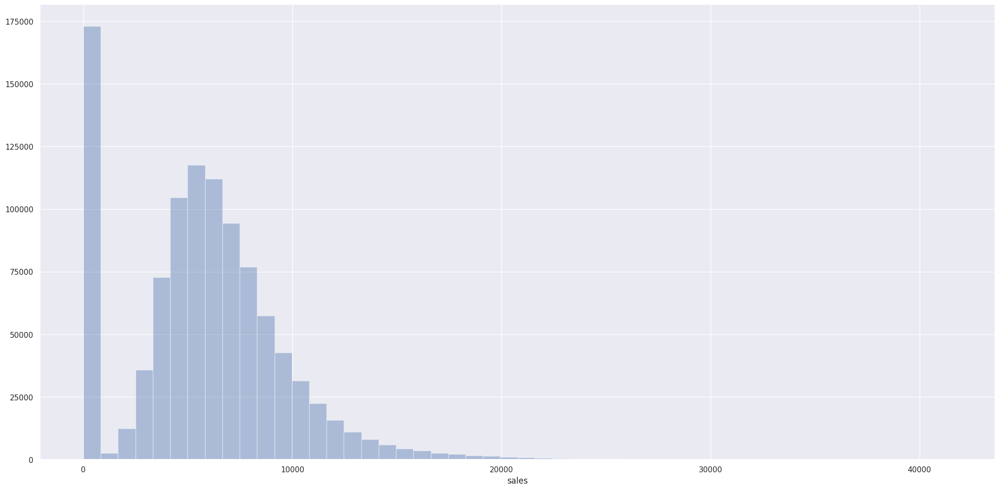

In [18]:
sns.distplot( df1['sales'], kde=False )

<Axes: xlabel='competition_distance'>

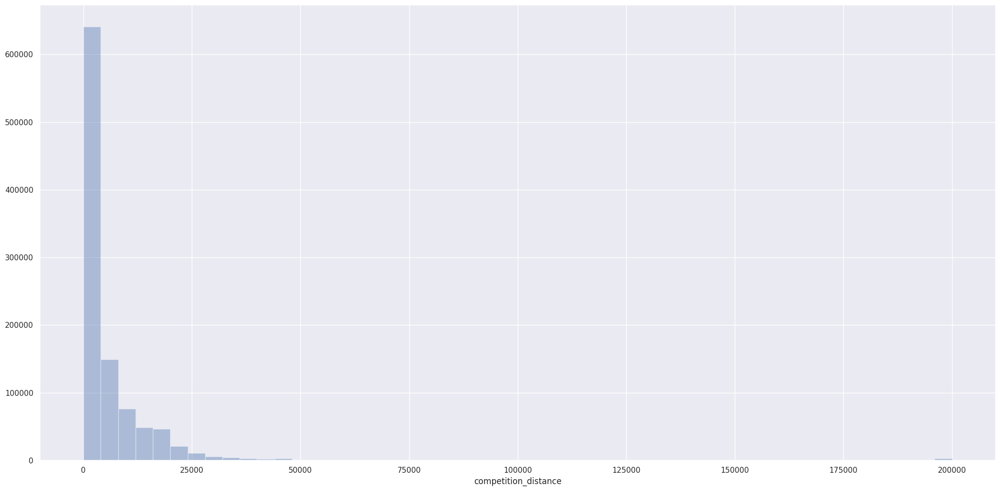

In [19]:
sns.distplot( df1['competition_distance'], kde=False )

### 1.7.2. Categorical Atributes

state_holiday      4
store_type         4
assortment         3
promo_interval     4
month_map         12
dtype: int64


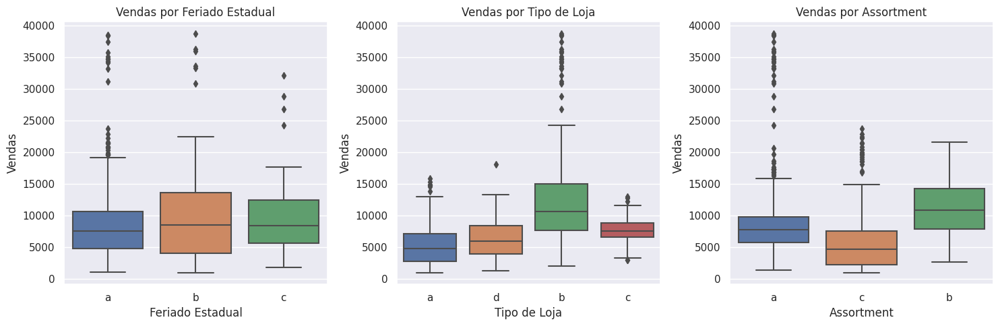

In [20]:
import seaborn as sns
import matplotlib.pyplot as plt

# Verifica o número de valores únicos em cada atributo categórico
num_unique = cat_attributes.apply(lambda x: x.unique().shape[0])
print(num_unique)

# Filtra os dados com state_holiday diferente de 0 e sales maiores que 0
aux = df1[(df1['state_holiday'] != '0') & (df1['sales'] > 0)]

# Cria uma figura com 3 subplots
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Boxplot para o atributo state_holiday
sns.boxplot(ax=axs[0], x='state_holiday', y='sales', data=aux)
axs[0].set_xlabel('Feriado Estadual')
axs[0].set_ylabel('Vendas')
axs[0].set_title('Vendas por Feriado Estadual')

# Boxplot para o atributo store_type
sns.boxplot(ax=axs[1], x='store_type', y='sales', data=aux)
axs[1].set_xlabel('Tipo de Loja')
axs[1].set_ylabel('Vendas')
axs[1].set_title('Vendas por Tipo de Loja')

# Boxplot para o atributo assortment
sns.boxplot(ax=axs[2], x='assortment', y='sales', data=aux)
axs[2].set_xlabel('Assortment')
axs[2].set_ylabel('Vendas')
axs[2].set_title('Vendas por Assortment')

plt.tight_layout()
plt.show()


In [21]:
cat_attributes.apply( lambda x: x.unique().shape[0] )

state_holiday      4
store_type         4
assortment         3
promo_interval     4
month_map         12
dtype: int64

<Axes: xlabel='assortment', ylabel='sales'>

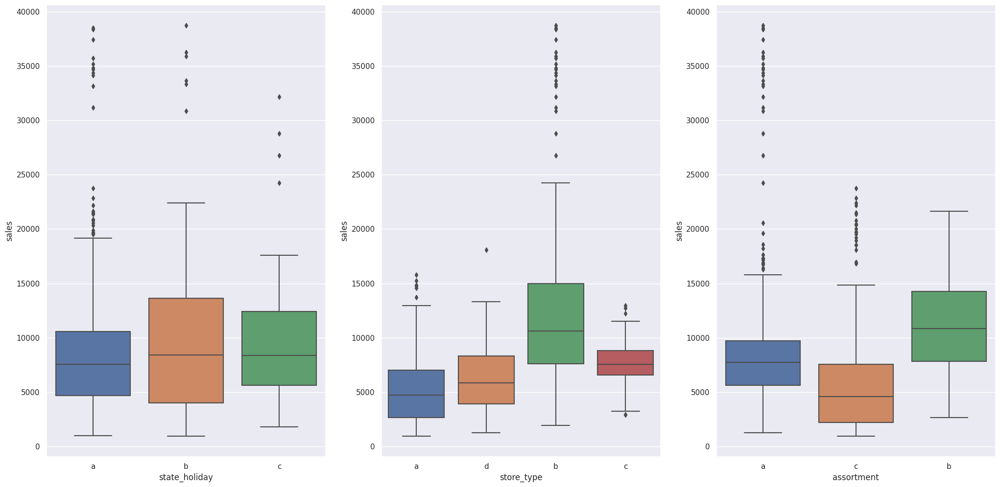

In [22]:
aux = df1[(df1['state_holiday'] != '0') & (df1['sales'] > 0)]

plt.subplot( 1, 3, 1 )
sns.boxplot( x='state_holiday', y='sales', data=aux )

plt.subplot( 1, 3, 2 )
sns.boxplot( x='store_type', y='sales', data=aux )

plt.subplot( 1, 3, 3 )
sns.boxplot( x='assortment', y='sales', data=aux )

# 2.0. PASSO 02 - FEATURE ENGINEERING

In [23]:
df2 = df1.copy()

## 2.1. Mapa Mental de Hipoteses

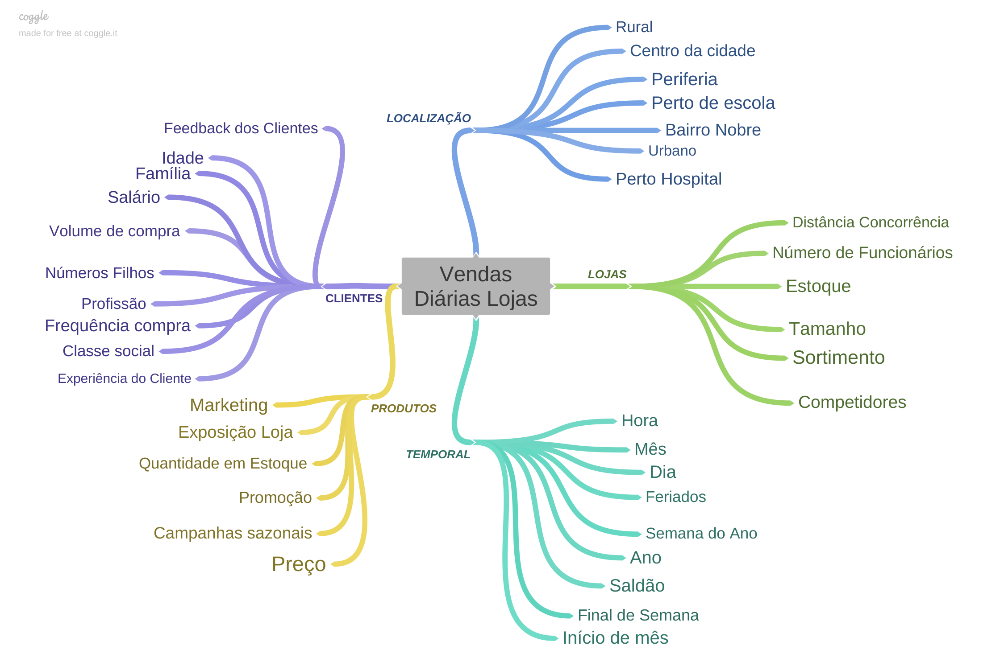

In [24]:
Image( '/content/Rossmann_Store_Sales/Vendas_Dirias_Lojas.png' )

## 2.2. Criacao das Hipoteses

### 2.2.1. Hipoteses Loja

**1.** Lojas com número maior de funcionários deveriam vender mais.

**2.** Lojas com maior capacidade de estoque deveriam vender mais.

**3.** Lojas com maior porte deveriam vender mais.

**4.** Lojas com maior sortimentos deveriam vender mais.

**5.** Lojas com competidores mais próximos deveriam vender menos.

**6.** Lojas com competidores à mais tempo deveriam vendem mais.

### 2.2.2. Hipoteses Produto

**1.** Lojas que investem mais em Marketing deveriam vender mais.

**2.** Lojas com maior exposição de produto deveriam vender mais.

**3.** Lojas com produtos com preço menor deveriam vender mais.

**5.** Lojas com promoções mais agressivas ( descontos maiores ), deveriam vender mais.

**6.** Lojas com promoções ativas por mais tempo deveriam vender mais.

**7.** Lojas com mais dias de promoção deveriam vender mais.

**8.** Lojas com mais promoções consecutivas deveriam vender mais.

### 2.2.3. Hipoteses Tempo

**1.** Lojas abertas durante o feriado de Natal deveriam vender mais.

**2.** Lojas deveriam vender mais ao longo dos anos.

**3.** Lojas deveriam vender mais no segundo semestre do ano.

**4.** Lojas deveriam vender mais depois do dia 10 de cada mês.

**5.** Lojas deveriam vender menos aos finais de semana.

**6.** Lojas deveriam vender menos durante os feriados escolares.

## 2.3. Lista Final de Hipóteses

**1.** Lojas com maior sortimentos deveriam vender mais.

**2.** Lojas com competidores mais próximos deveriam vender menos.

**3.** Lojas com competidores à mais tempo deveriam vendem mais.

**4.** Lojas com promoções ativas por mais tempo deveriam vender mais.

**5.** Lojas com mais dias de promoção deveriam vender mais.

**7.** Lojas com mais promoções consecutivas deveriam vender mais.

**8.** Lojas abertas durante o feriado de Natal deveriam vender mais.

**9.** Lojas deveriam vender mais ao longo dos anos.

**10.** Lojas deveriam vender mais no segundo semestre do ano.

**11.** Lojas deveriam vender mais depois do dia 10 de cada mês.

**12.** Lojas deveriam vender menos aos finais de semana.

**13.** Lojas deveriam vender menos durante os feriados escolares.


## 2.4. Feature Engineering

In [25]:
# year
df2['year'] = df2['date'].dt.year

# month
df2['month'] = df2['date'].dt.month

# day
df2['day'] = df2['date'].dt.day

# week of year
df2['week_of_year'] = df2['date'].dt.isocalendar().week 

# year week
df2['year_week'] = df2['date'].dt.strftime( '%Y-%W' )

# competition since
df2['competition_since'] = df2.apply( lambda x: datetime.datetime( year=x['competition_open_since_year'], month=x['competition_open_since_month'],day=1 ), axis=1 )
df2['competition_time_month'] = ( ( df2['date'] - df2['competition_since'] )/30 ).apply( lambda x: x.days ).astype( int )

# promo since
df2['promo_since'] = df2['promo2_since_year'].astype( str ) + '-' + df2['promo2_since_week'].astype( str )
df2['promo_since'] = df2['promo_since'].apply( lambda x: datetime.datetime.strptime( x + '-1', '%Y-%W-%w' ) - datetime.timedelta( days=7 ) )
df2['promo_time_week'] = ( ( df2['date'] - df2['promo_since'] )/7 ).apply( lambda x: x.days ).astype( int )

# assortment
df2['assortment'] = df2['assortment'].apply( lambda x: 'basic' if x == 'a' else 'extra' if x == 'b' else 'extended' )

# state holiday
df2['state_holiday'] = df2['state_holiday'].apply( lambda x: 'public_holiday' if x == 'a' else 'easter_holiday' if x == 'b' else 'christmas' if x == 'c' else 'regular_day' )

# 3.0. PASSO 03 - FILTRAGEM DE VARIÁVEIS

In [26]:
df3 = df2.copy()

## 3.1. Filtragem das Linhas


In [27]:
df3 = df3[(df3['open'] != 0) & (df3['sales'] > 0)]

## 3.2. Selecao das Colunas

In [28]:
cols_drop = ['customers', 'open', 'promo_interval', 'month_map']
df3 = df3.drop( cols_drop, axis=1 )

In [29]:
df3.head().T

,0,1,2,3,4
store,1,2,3,4,5
day_of_week,5,5,5,5,5
date,2015-07-31 00:00:00,2015-07-31 00:00:00,2015-07-31 00:00:00,2015-07-31 00:00:00,2015-07-31 00:00:00
sales,5263,6064,8314,13995,4822
promo,1,1,1,1,1
state_holiday,regular_day,regular_day,regular_day,regular_day,regular_day
school_holiday,1,1,1,1,1
store_type,c,a,a,c,a
assortment,basic,basic,basic,extended,basic
competition_distance,1270.0,570.0,14130.0,620.0,29910.0


# 4.0. PASSO 04 - ANALISE EXPLORATORIA DE DADOS

In [30]:
df4 = df3.copy()

## 4.1. ANALISE UNIVARIADA ( Olhar únicamente para cada variável )

### 4.1.1. Response Variable 

In [31]:
import plotly.express as px

fig = px.histogram(df4, x='sales', nbins=20)
fig.update_layout(title='Distribuição das vendas', xaxis_title='Vendas', yaxis_title='Contagem')
fig.show()

In [32]:
import plotly.express as px

# Gráfico de histograma das vendas
fig1 = px.histogram(df4, x='sales', nbins=20)
fig1.update_layout(title='Distribuição das vendas', xaxis_title='Vendas', yaxis_title='Contagem')
fig1.show()

# Gráfico de dispersão das vendas em relação ao número de competidores
fig2 = px.scatter(df4, x='competition_distance', y='sales', trendline='ols')
fig2.update_layout(title='Vendas em relação à distância dos competidores', xaxis_title='Distância dos competidores', yaxis_title='Vendas')
fig2.show()

Text(0.5, 1.0, 'Distribuição das vendas')

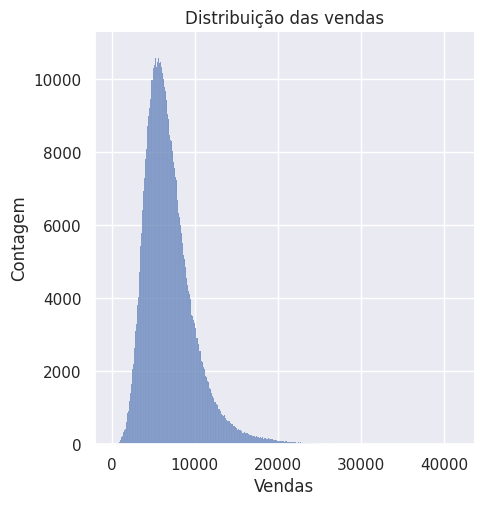

In [33]:
import seaborn as sns

sns.displot(df4['sales'])
plt.xlabel('Vendas')
plt.ylabel('Contagem')
plt.title('Distribuição das vendas')

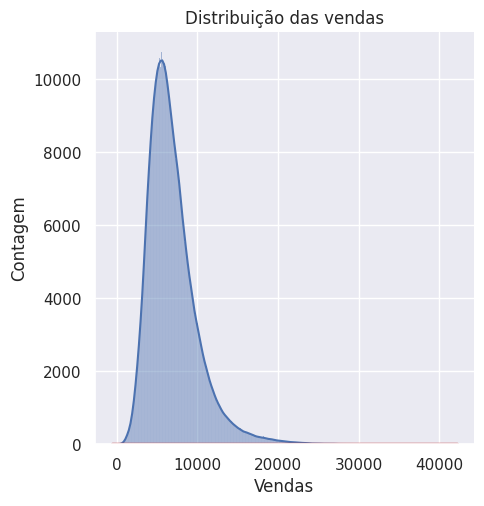

In [34]:
import seaborn as sns

sns.displot(df4['sales'], kde=True)
sns.kdeplot(df4['sales'], color='r', linewidth=2.5)
plt.xlabel('Vendas')
plt.ylabel('Contagem')
plt.title('Distribuição das vendas')
plt.show()

### 4.1.2. Numerical Variable 

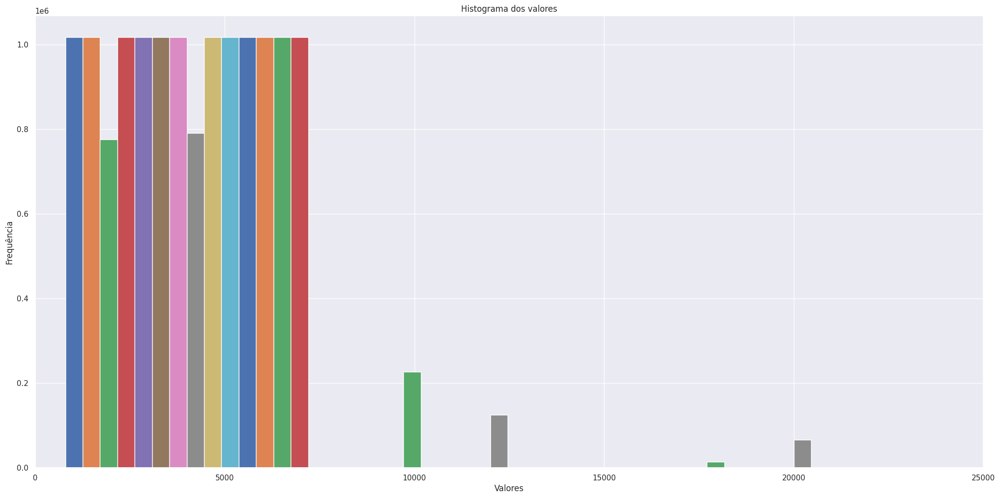

In [35]:
import matplotlib.pyplot as plt

plt.hist(num_attributes, bins=25)
plt.xlabel('Valores')
plt.ylabel('Frequência')
plt.title('Histograma dos valores')
plt.xlim(0, 25000)
plt.show()


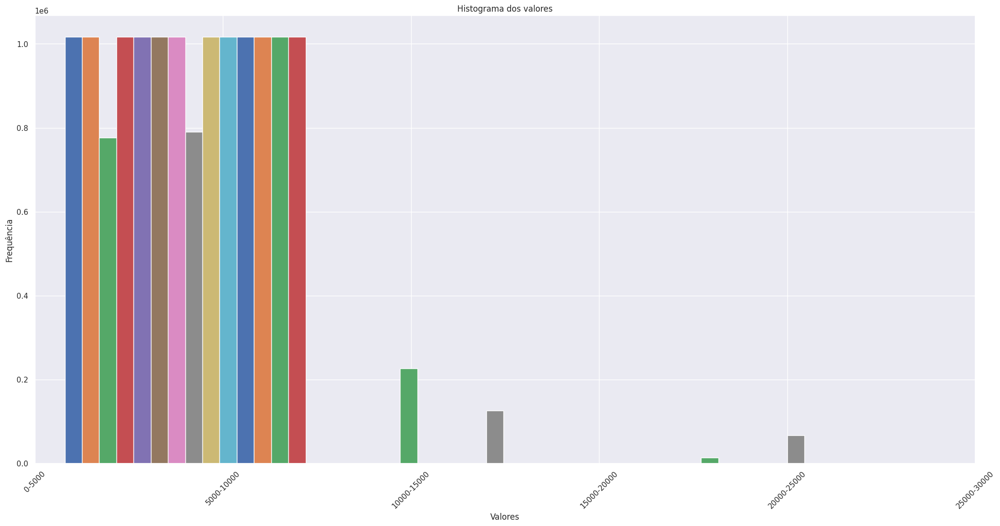

In [36]:
import matplotlib.pyplot as plt

plt.hist(num_attributes, bins=25)
plt.xlabel('Valores')
plt.ylabel('Frequência')
plt.title('Histograma dos valores')
plt.xlim(0, 25000)

# Define as marcações do eixo x com intervalo de 5000 e número de valores por marcação igual a 100
plt.xticks(range(0, 25001, 5000), [str(x) + "-" + str(x+5000) for x in range(0, 25001, 5000)], rotation=45)

plt.show()

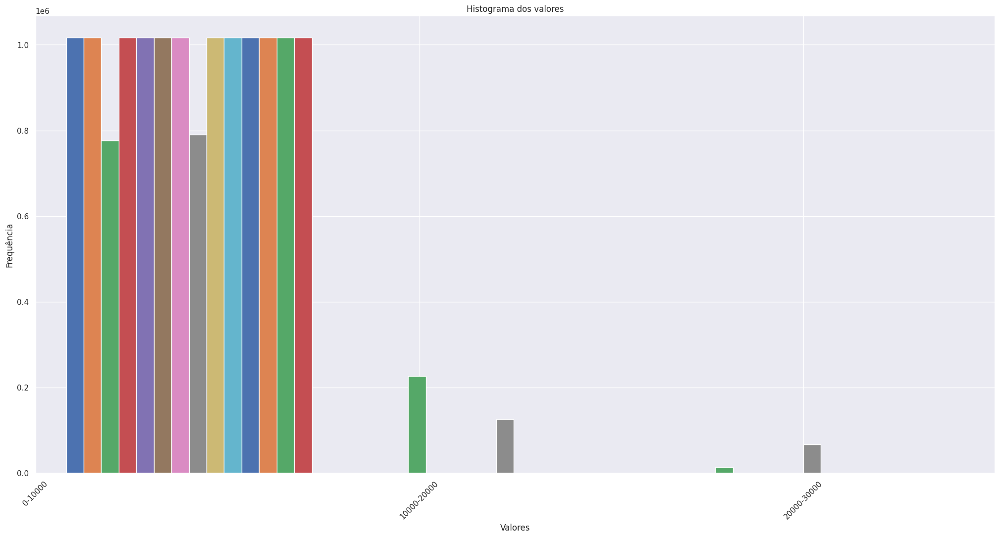

In [37]:
import matplotlib.pyplot as plt

plt.hist(num_attributes, bins=25)
plt.xlabel('Valores')
plt.ylabel('Frequência')
plt.title('Histograma dos valores')
plt.xlim(0, 25000)

# Define as marcações do eixo x com intervalo de 10000 e número de valores por marcação igual a 200
plt.xticks(range(0, 25001, 10000), [str(x) + "-" + str(x+10000) for x in range(0, 25001, 10000)], rotation=45)

plt.show()

Text(0.5, 1.0, 'Histograma dos valores')

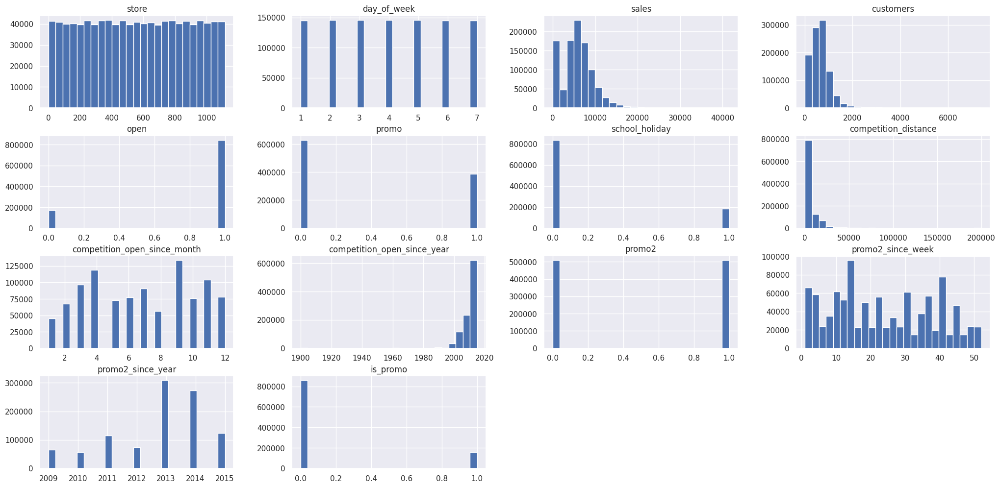

In [38]:
num_attributes.hist(bins=25)
plt.xlabel('Valores')
plt.ylabel('Frequência')
plt.title('Histograma dos valores')

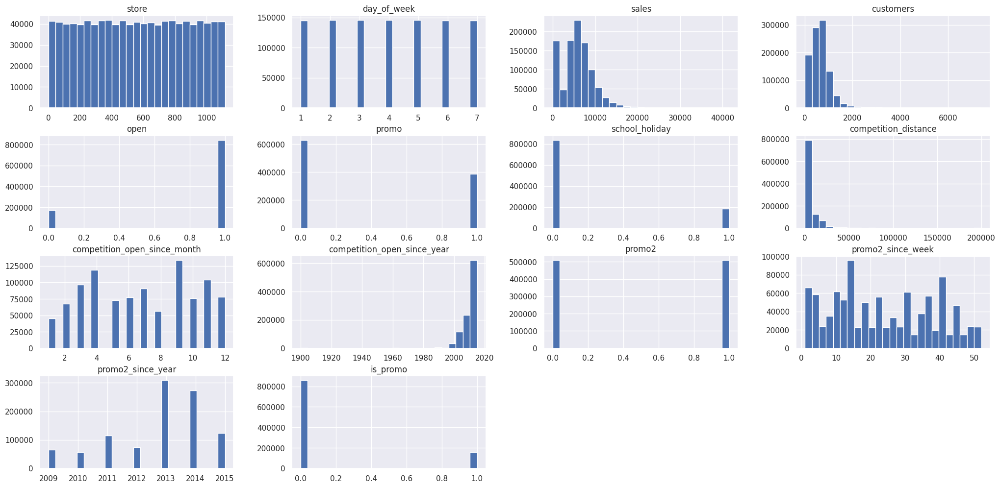

In [39]:
num_attributes.hist( bins=25 );

### 4.1.3. Categorical Variable 

In [40]:
df4['store_type'].drop_duplicates()

0     c
1     a
12    d
84    b
Name: store_type, dtype: object

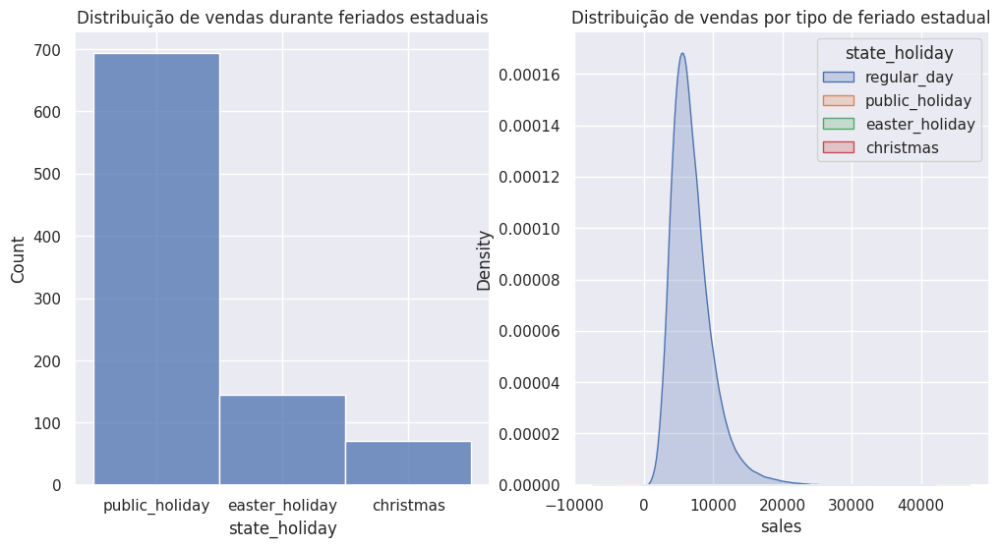

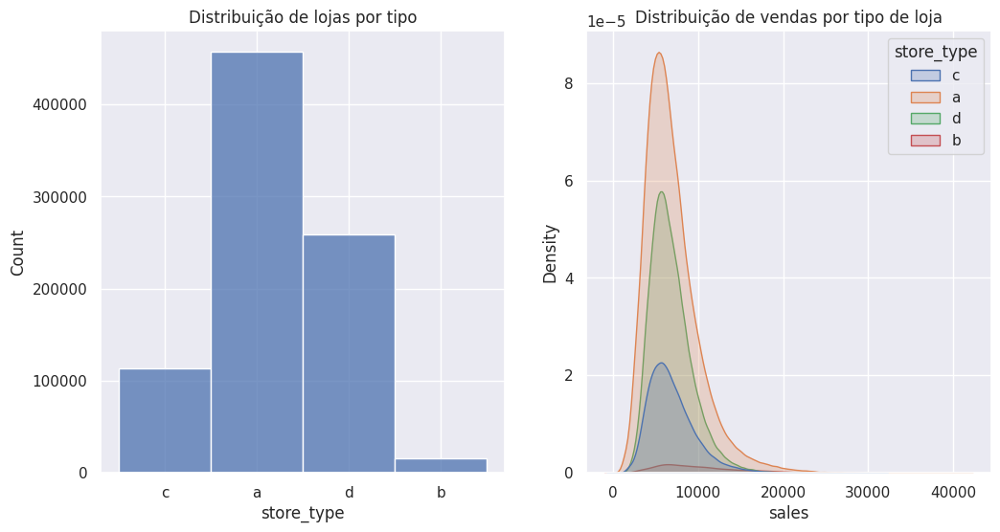

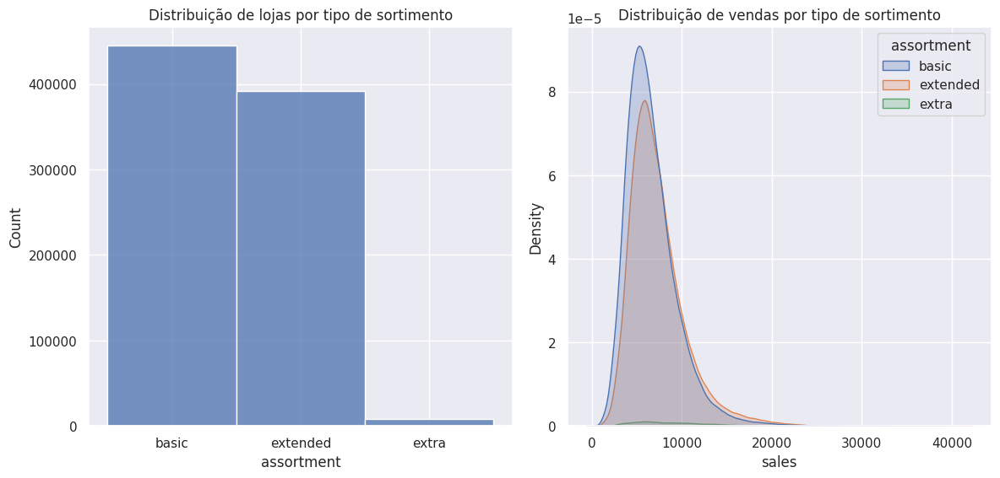

In [41]:
import seaborn as sns
import matplotlib.pyplot as plt

# Análise de estado de feriado
fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))
ax1, ax2 = axs.flatten()

state_holiday = df4[df4['state_holiday'] != 'regular_day']
sns.histplot(state_holiday['state_holiday'], ax=ax1)
ax1.set_title("Distribuição de vendas durante feriados estaduais")

sns.kdeplot(data=df4, x="sales", hue="state_holiday", fill=True, ax=ax2)
ax2.set_title("Distribuição de vendas por tipo de feriado estadual")

# Análise de tipo de loja
fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))
ax1, ax2 = axs.flatten()

sns.histplot(df4['store_type'], ax=ax1)
ax1.set_title("Distribuição de lojas por tipo")

sns.kdeplot(data=df4, x="sales", hue="store_type", fill=True, ax=ax2)
ax2.set_title("Distribuição de vendas por tipo de loja")

# Análise de sortimento
fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))
ax1, ax2 = axs.flatten()

sns.histplot(df4['assortment'], ax=ax1)
ax1.set_title("Distribuição de lojas por tipo de sortimento")

sns.kdeplot(data=df4, x="sales", hue="assortment", fill=True, ax=ax2)
ax2.set_title("Distribuição de vendas por tipo de sortimento")

plt.tight_layout()
plt.show()

<Axes: xlabel='sales', ylabel='Density'>

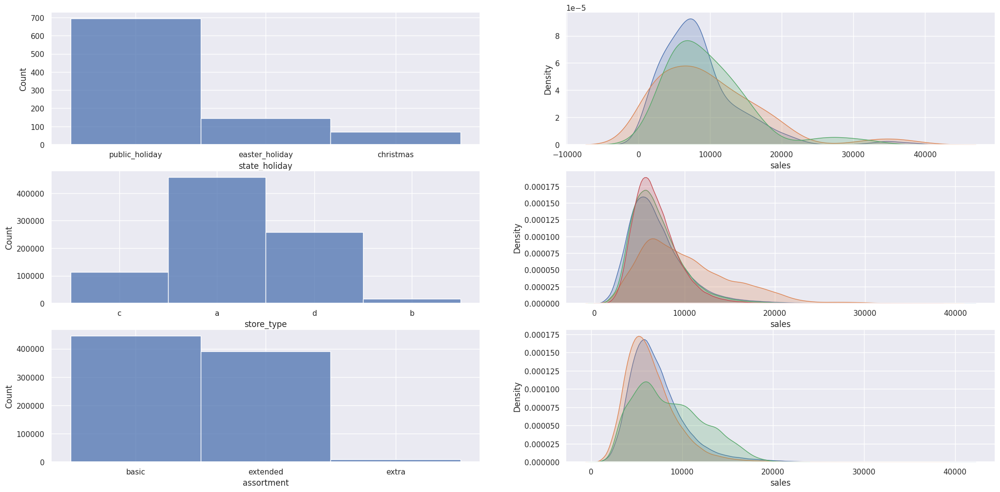

In [42]:
# state_holiday
plt.subplot( 3, 2, 1 )
a = df4[df4['state_holiday'] != 'regular_day']
sns.histplot( a['state_holiday'] )

plt.subplot( 3, 2, 2 )
sns.kdeplot( df4[df4['state_holiday'] == 'public_holiday']['sales'], label='public_holiday', fill=True )
sns.kdeplot( df4[df4['state_holiday'] == 'easter_holiday']['sales'], label='easter_holiday', fill=True )
sns.kdeplot( df4[df4['state_holiday'] == 'christmas']['sales'], label='christmas', fill=True )

#store_type
plt.subplot( 3, 2, 3 )
sns.histplot( df4['store_type'] )

plt.subplot( 3, 2, 4 )
sns.kdeplot( df4[df4['store_type'] == 'a']['sales'], label='a', fill=True )
sns.kdeplot( df4[df4['store_type'] == 'b']['sales'], label='b', fill=True )
sns.kdeplot( df4[df4['store_type'] == 'c']['sales'], label='c', fill=True )
sns.kdeplot( df4[df4['store_type'] == 'd']['sales'], label='d', fill=True )

#assortment
plt.subplot( 3, 2, 5 )
sns.histplot( df4['assortment'] )

plt.subplot( 3, 2, 6 )
sns.kdeplot( df4[df4['assortment'] == 'extended']['sales'], label='extended', fill=True )
sns.kdeplot( df4[df4['assortment'] == 'basic']['sales'], label='basic', fill=True )
sns.kdeplot( df4[df4['assortment'] == 'extra']['sales'], label='extra', fill=True )
sns.kdeplot( df4[df4['assortment'] == 'd']['sales'], label='d', fill=True )

## 4.2. ANALISE BIVARIADA ( Encontrar o impacto de uma variável em relação a variável resposta )

### H1. Lojas com maior sortimentos deveriam vender mais.
### ***FALSA*** Lojas com maior sortimento vendem menos.

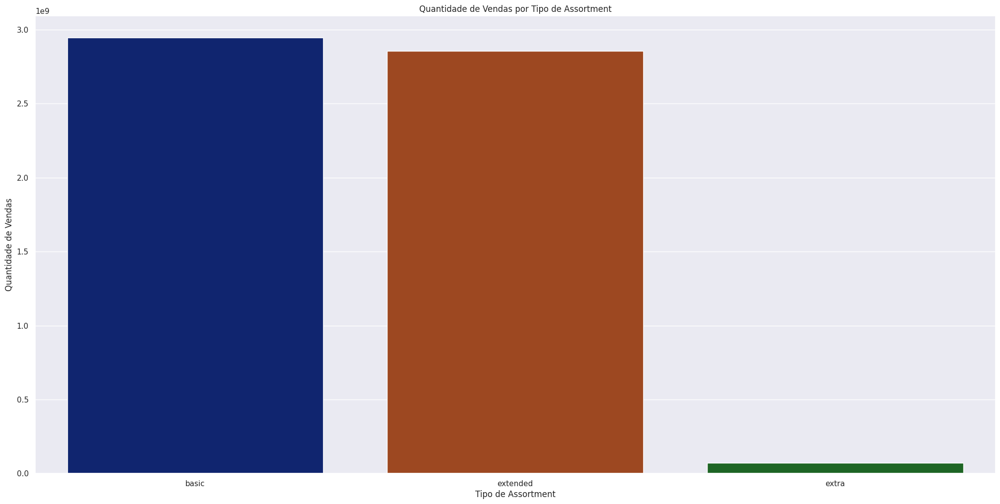

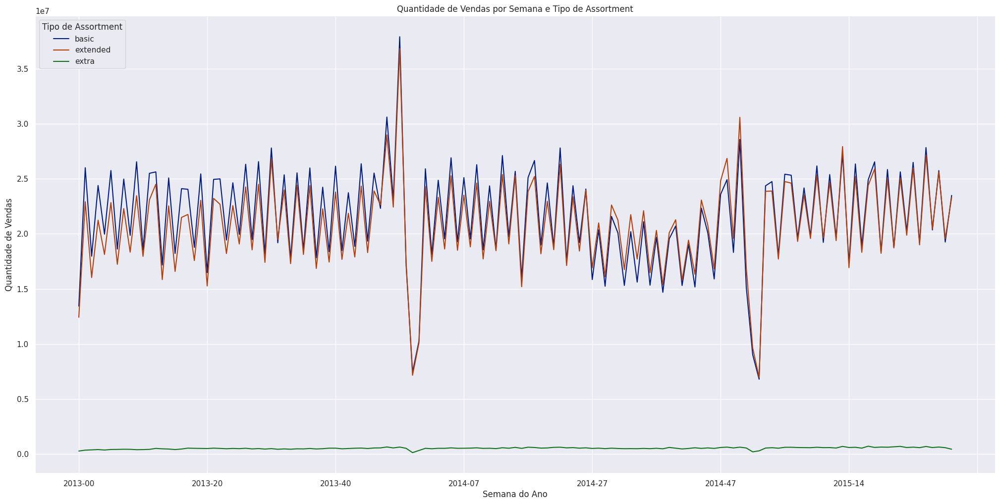

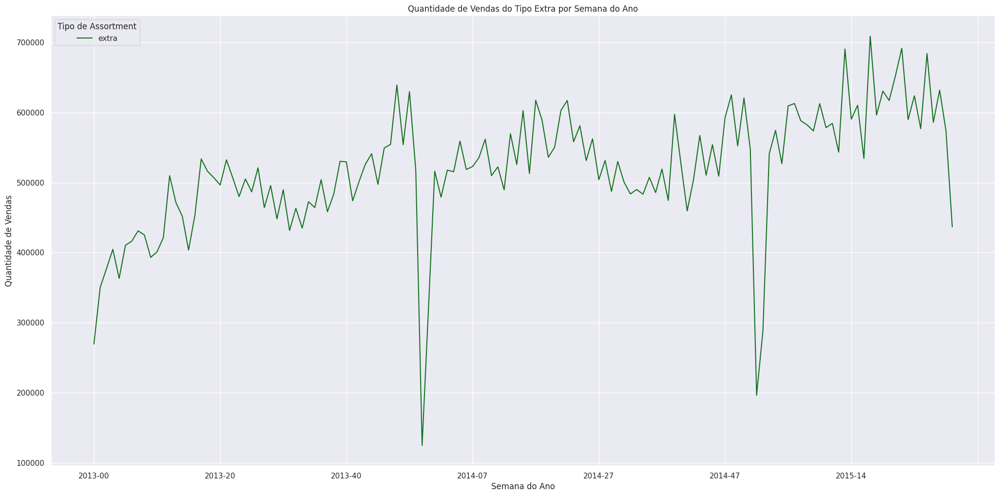

In [43]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


# Calcula a quantidade de venda por tipo de assortment
vendas_por_assortment = df4.groupby('assortment')['sales'].sum().reset_index()

# Define a paleta de cores escuras
cores = sns.color_palette("dark", len(vendas_por_assortment))

# Gera o gráfico de barras
grafico_vendas_por_assortment = sns.barplot(x='assortment', y='sales', data=vendas_por_assortment, palette=cores)
grafico_vendas_por_assortment.set(title='Quantidade de Vendas por Tipo de Assortment', xlabel='Tipo de Assortment', ylabel='Quantidade de Vendas')

# Calcula a quantidade de venda por semana e tipo de assortment
vendas_por_semana_e_assortment = df4.groupby(['year_week', 'assortment'])['sales'].sum().reset_index()

# Gera o gráfico de linhas
grafico_vendas_por_semana_e_assortment = vendas_por_semana_e_assortment.pivot(index='year_week', columns='assortment', values='sales').plot(color=cores)
grafico_vendas_por_semana_e_assortment.set(title='Quantidade de Vendas por Semana e Tipo de Assortment', xlabel='Semana do Ano', ylabel='Quantidade de Vendas')
grafico_vendas_por_semana_e_assortment.legend(title='Tipo de Assortment', loc='upper left')

# Filtra as vendas do tipo 'extra' por semana do ano
vendas_extra_por_semana = vendas_por_semana_e_assortment[vendas_por_semana_e_assortment['assortment'] == 'extra']
grafico_vendas_extra_por_semana = vendas_extra_por_semana.pivot(index='year_week', columns='assortment', values='sales').plot(color=cores[2])
grafico_vendas_extra_por_semana.set(title='Quantidade de Vendas do Tipo Extra por Semana do Ano', xlabel='Semana do Ano', ylabel='Quantidade de Vendas')
grafico_vendas_extra_por_semana.legend(title='Tipo de Assortment', loc='upper left')


<Axes: xlabel='year_week'>

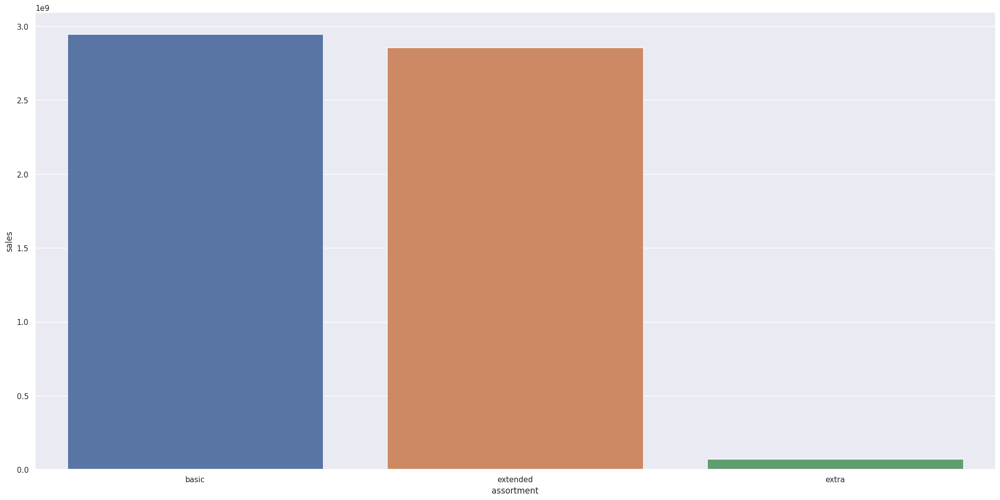

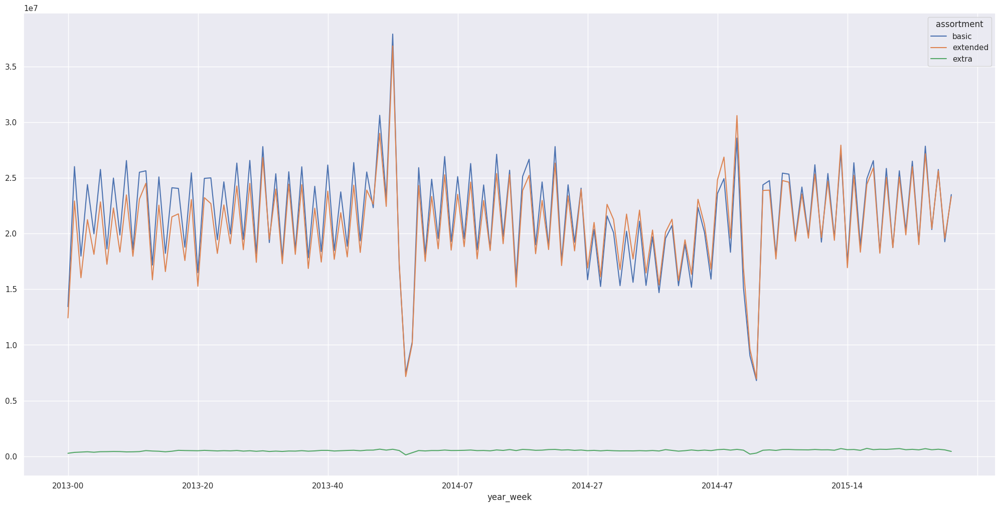

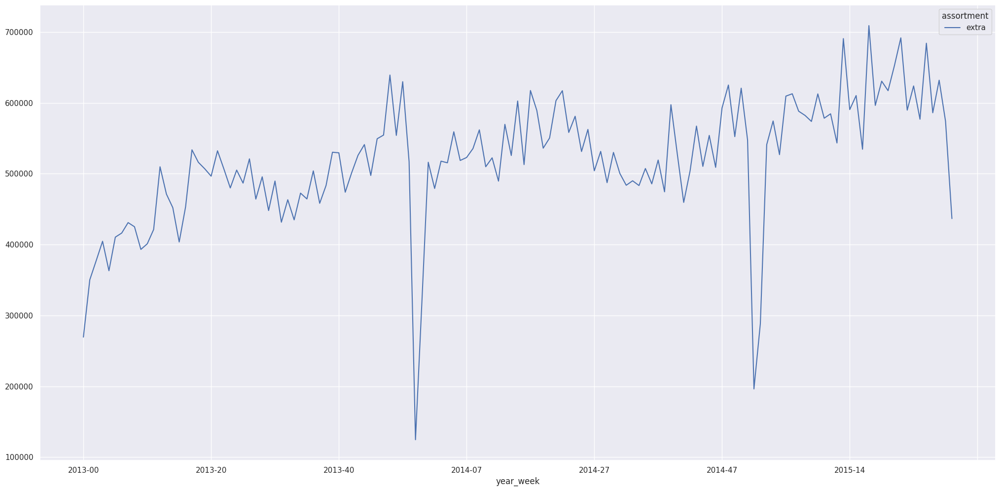

In [44]:
#Quantidade de venda por tipo de assortment
aux1 = df4[['assortment', 'sales']].groupby( 'assortment' ).sum().reset_index() 
sns.barplot( x='assortment', y='sales', data=aux1 );

aux2 = df4[[ 'year_week', 'assortment', 'sales']].groupby( ['year_week','assortment'] ).sum().reset_index()
aux2.pivot( index='year_week', columns='assortment', values='sales' ).plot()

aux3 = aux2[aux2['assortment'] == 'extra' ]
aux3.pivot( index='year_week', columns='assortment', values='sales' ).plot()

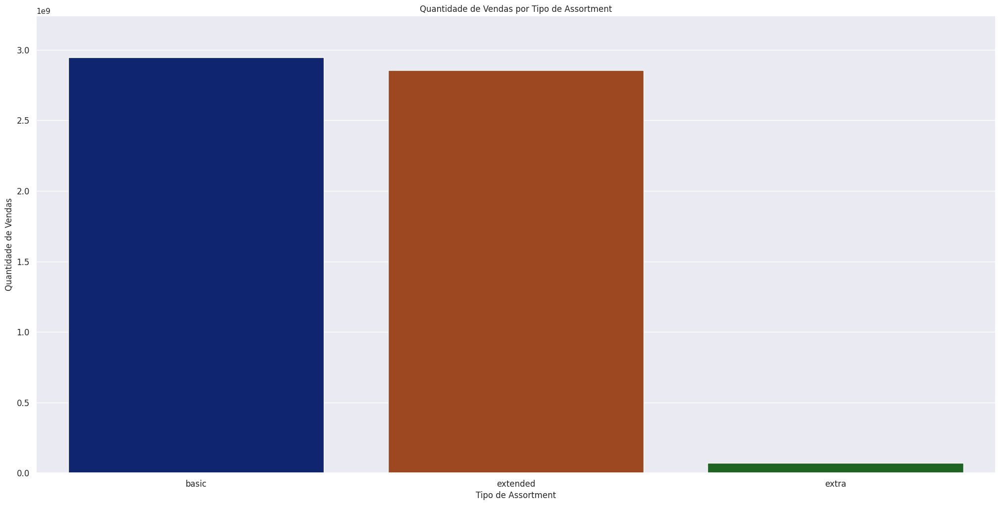

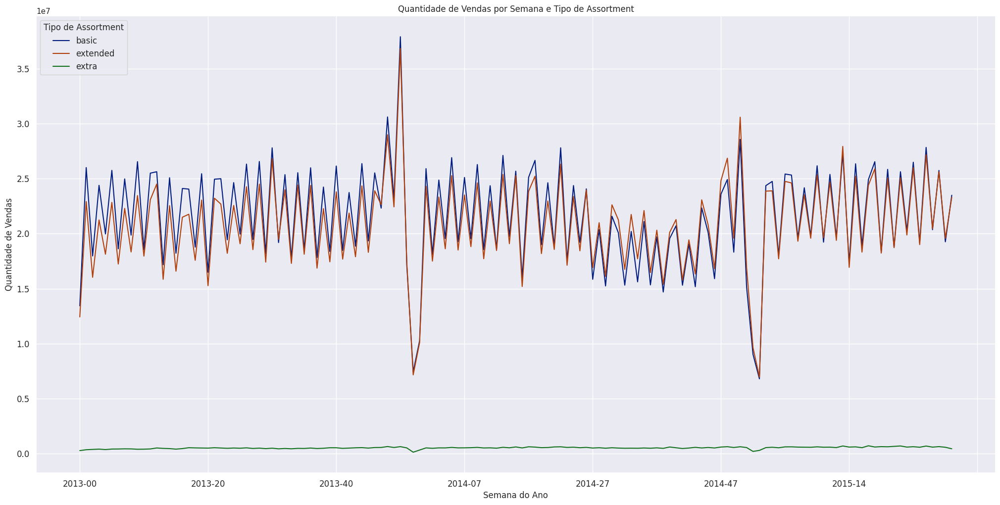

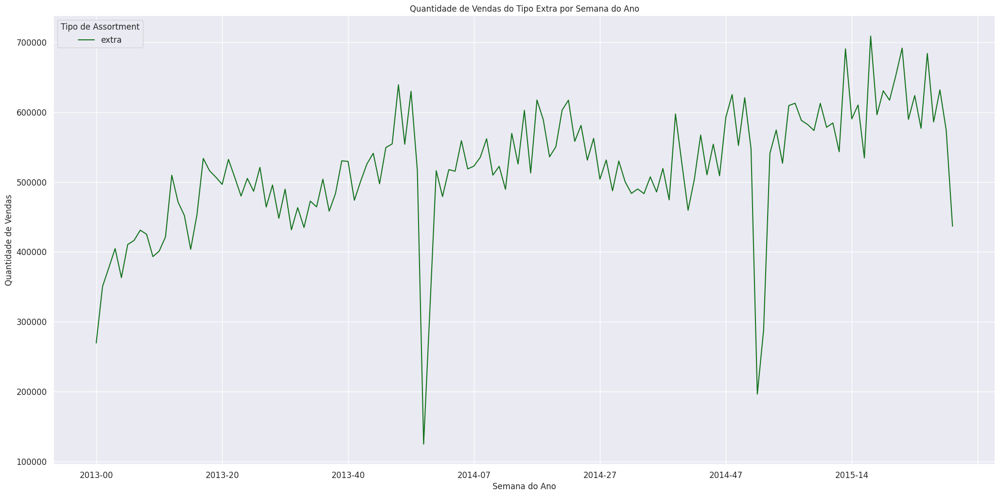

In [45]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


# Calcula a quantidade de venda por tipo de assortment
vendas_por_assortment = df4.groupby('assortment')['sales'].sum().reset_index()

# Define a paleta de cores escuras
cores = sns.color_palette("dark", len(vendas_por_assortment))

# Gera o gráfico de barras
grafico_vendas_por_assortment = sns.barplot(x='assortment', y='sales', data=vendas_por_assortment, palette=cores)
grafico_vendas_por_assortment.set(title='Quantidade de Vendas por Tipo de Assortment', xlabel='Tipo de Assortment', ylabel='Quantidade de Vendas')
grafico_vendas_por_assortment.tick_params(axis='both', which='major', labelsize=12)
grafico_vendas_por_assortment.set_ylim(0, vendas_por_assortment['sales'].max() * 1.1)

# Calcula a quantidade de venda por semana e tipo de assortment
vendas_por_semana_e_assortment = df4.groupby(['year_week', 'assortment'])['sales'].sum().reset_index()

# Gera o gráfico de linhas
grafico_vendas_por_semana_e_assortment = vendas_por_semana_e_assortment.pivot(index='year_week', columns='assortment', values='sales').plot(color=cores)
grafico_vendas_por_semana_e_assortment.set(title='Quantidade de Vendas por Semana e Tipo de Assortment', xlabel='Semana do Ano', ylabel='Quantidade de Vendas')
grafico_vendas_por_semana_e_assortment.legend(title='Tipo de Assortment', loc='upper left', fontsize=12)
grafico_vendas_por_semana_e_assortment.tick_params(axis='both', which='major', labelsize=12)

# Filtra as vendas do tipo 'extra' por semana do ano
vendas_extra_por_semana = vendas_por_semana_e_assortment[vendas_por_semana_e_assortment['assortment'] == 'extra']
grafico_vendas_extra_por_semana = vendas_extra_por_semana.pivot(index='year_week', columns='assortment', values='sales').plot(color=cores[2])
grafico_vendas_extra_por_semana.set(title='Quantidade de Vendas do Tipo Extra por Semana do Ano', xlabel='Semana do Ano', ylabel='Quantidade de Vendas')
grafico_vendas_extra_por_semana.legend(title='Tipo de Assortment', loc='upper left', fontsize=12)
grafico_vendas_extra_por_semana.tick_params(axis='both', which='major', labelsize=12)


### H2. Lojas com competidores mais próximos deveriam vender menos.
### ***FALSA*** Lojas com COMPETIDORES MAIS PROXIMOS vendem MAIS.

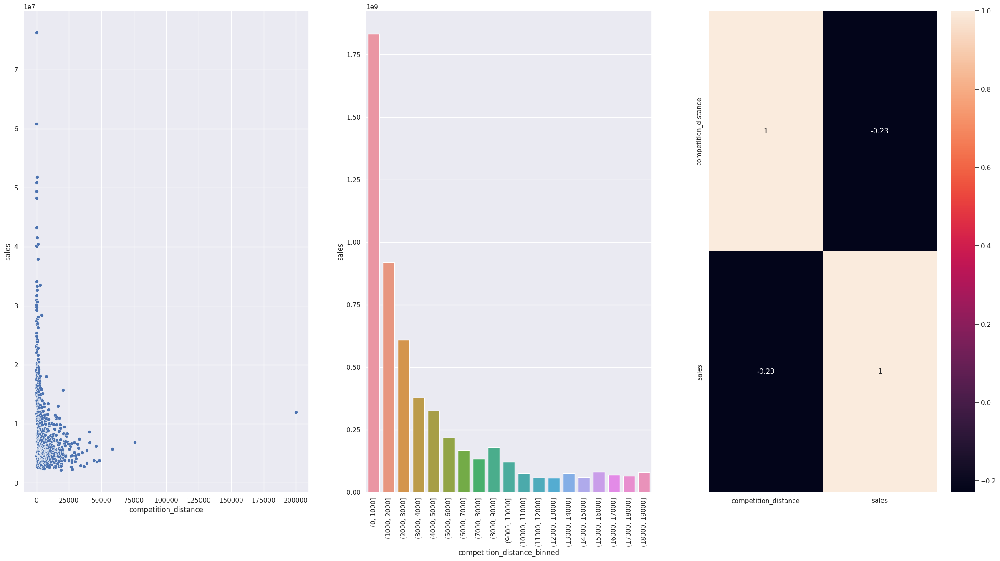

In [46]:
plt.rcParams.update({'figure.figsize':(30,15), 'figure.dpi':100})

aux1 = df4[['competition_distance', 'sales']].groupby( 'competition_distance' ).sum().reset_index()

plt.subplot( 1, 3, 1 )
sns.scatterplot( x ='competition_distance', y='sales', data=aux1 );

plt.subplot( 1, 3, 2 )
bins = list( np.arange( 0, 20000, 1000 ) )
aux1['competition_distance_binned'] = pd.cut( aux1['competition_distance'], bins=bins )
aux2 = aux1[['competition_distance_binned', 'sales']].groupby( 'competition_distance_binned' ).sum().reset_index()
sns.barplot( x='competition_distance_binned', y='sales', data=aux2 );
plt.xticks( rotation=90 );

plt.subplot( 1, 3, 3 )
sns.heatmap( aux1.corr( method='pearson' ), annot=True );

### H3. Lojas com competidores à mais tempo deveriam vender mais.
### ***FALSA*** Lojas com COMPETIDORES À MAIS TEMPO vendem MENOS.

In [ ]:
plt.rcParams.update({'figure.figsize':(30,15), 'figure.dpi':100})

# Gráfico de barras
plt.subplot(1, 3, 1)
aux1 = df4[['competition_time_month', 'sales']].groupby('competition_time_month').sum().reset_index()
aux2 = aux1[(aux1['competition_time_month'] < 120) & (aux1['competition_time_month'] != 0)]
sns.barplot(x='competition_time_month', y='sales', data=aux2)
plt.xticks(rotation=90, fontsize=20)
plt.xlabel('Tempo de Competição (meses)', fontsize=20)
plt.ylabel('Vendas', fontsize=20)
plt.title('Vendas por tempo de competição', fontsize=25)

# Gráfico de dispersão
plt.subplot(1, 3, 2)
sns.regplot(x='competition_time_month', y='sales', data=aux2)
plt.xlabel('Tempo de Competição (meses)', fontsize=20)
plt.ylabel('Vendas', fontsize=20)
plt.title('Vendas por tempo de competição', fontsize=25)

# Mapa de calor
plt.subplot(1, 3, 3)
corr = aux1.corr(method='pearson')
sns.heatmap(corr, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlação entre tempo de competição e vendas', fontsize=25)

# Ajuste da visualização do mapa de calor
bottom, top = x.get_ylim()
x.set_ylim(bottom+0.5, top-0.5)

# Exibição dos gráficos
plt.show()


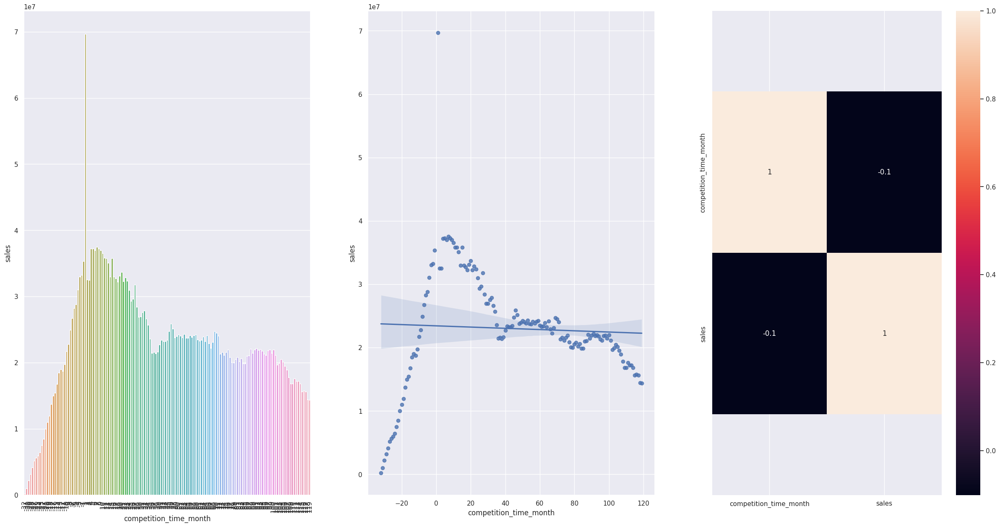

In [49]:
plt.subplot(  1, 3, 1 )
aux1 = df4[['competition_time_month', 'sales']].groupby( 'competition_time_month' ).sum().reset_index()
aux2 = aux1[( aux1['competition_time_month'] < 120 ) & ( aux1['competition_time_month'] != 0 )]
sns.barplot( x='competition_time_month', y='sales', data=aux2 );
plt.xticks( rotation=90 );

plt.subplot(  1, 3, 2 )
sns.regplot( x='competition_time_month', y='sales', data=aux2 );

plt.subplot(  1, 3, 3 )
x = sns.heatmap( aux1.corr( method='pearson'), annot=True );
bottom, top = x.get_ylim()
x.set_ylim( bottom+0.5, top-0.5);

### H4. Lojas com promoções ativas por mais tempo deveriam vender mais.
### ***FALSA*** Lojas com promoções ativas por mais tempo, vendem menos depois de um certo período de promoção.

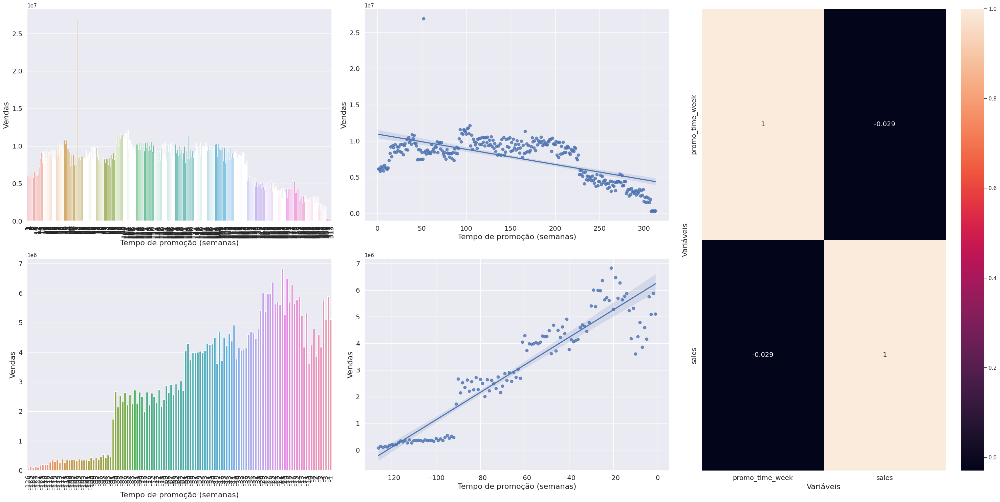

In [50]:
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.gridspec import GridSpec

plt.rcParams.update({'figure.figsize':(30,15), 'figure.dpi':100})

# Gráfico de barras para promoções estendidas
aux1 = df4[['promo_time_week', 'sales']].groupby('promo_time_week').sum().reset_index()
aux2 = aux1[aux1['promo_time_week'] > 0] # promoções estendidas
plt.subplot(GridSpec(2, 3)[0, 0])
sns.barplot(x='promo_time_week', y='sales', data=aux2)
plt.xticks(rotation=90, fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel('Tempo de promoção (semanas)', fontsize=16)
plt.ylabel('Vendas', fontsize=16)

# Gráfico de regressão para promoções estendidas
plt.subplot(GridSpec(2, 3)[0, 1])
sns.regplot(x='promo_time_week', y='sales', data=aux2)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel('Tempo de promoção (semanas)', fontsize=16)
plt.ylabel('Vendas', fontsize=16)

# Gráfico de barras para promoções regulares
aux3 = aux1[aux1['promo_time_week'] < 0] # promoções regulares
plt.subplot(GridSpec(2, 3)[1, 0])
sns.barplot(x='promo_time_week', y='sales', data=aux3)
plt.xticks(rotation=90, fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel('Tempo de promoção (semanas)', fontsize=16)
plt.ylabel('Vendas', fontsize=16)

# Gráfico de regressão para promoções regulares
plt.subplot(GridSpec(2, 3)[1, 1])
sns.regplot(x='promo_time_week', y='sales', data=aux3)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel('Tempo de promoção (semanas)', fontsize=16)
plt.ylabel('Vendas', fontsize=16)

# Heatmap de correlação
plt.subplot(GridSpec(2, 3)[:, 2])
sns.heatmap(aux1.corr(method='pearson'), annot=True, annot_kws={'fontsize':14})
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel('Variáveis', fontsize=16)
plt.ylabel('Variáveis', fontsize=16)

plt.tight_layout()
plt.show()

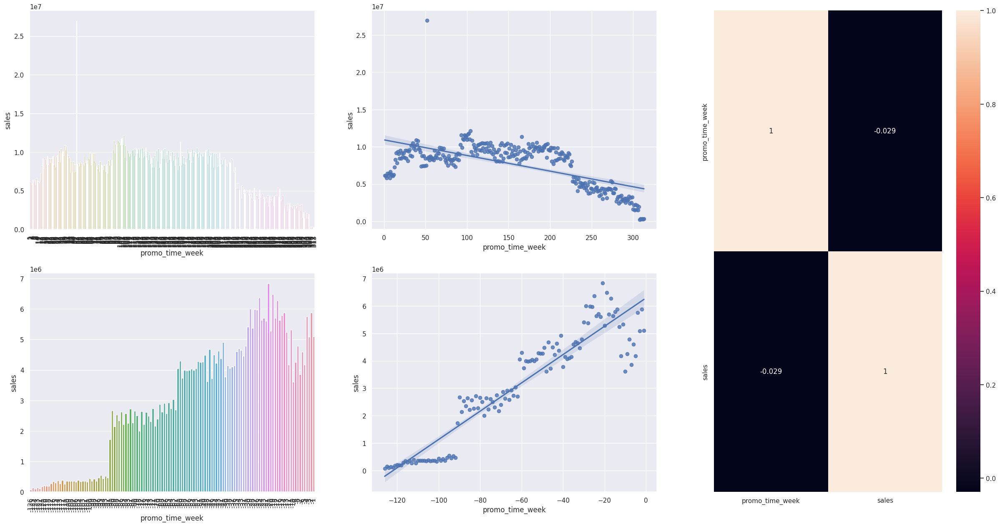

In [51]:
aux1 = df4[['promo_time_week', 'sales']].groupby( 'promo_time_week').sum().reset_index()

grid = GridSpec( 2, 3 )

plt.subplot( grid[0,0] )
aux2 = aux1[aux1['promo_time_week'] > 0] # promo extendida
sns.barplot( x='promo_time_week' , y='sales', data=aux2 );
plt.xticks( rotation=90 );

plt.subplot( grid[0,1] )
sns.regplot( x='promo_time_week' , y='sales', data=aux2 );

plt.subplot( grid[1,0] )
aux3 = aux1[aux1['promo_time_week'] < 0] # promo regular
sns.barplot( x='promo_time_week' , y='sales', data=aux3 );
plt.xticks( rotation=90 );

plt.subplot( grid[1,1] )
sns.regplot( x='promo_time_week' , y='sales', data=aux3 );

plt.subplot( grid[:,2] )
sns.heatmap( aux1.corr(method='pearson' ), annot=True );

### H5. Lojas com mais dias de promoção deveriam vender mais. #Validar no próximo ciclo

### H7. Lojas com mais promoções consecutivas deveriam vender mais.
### ***FALSA*** Lojas com mais promoções consecutivas vendem menos.

In [52]:
df4[['promo', 'promo2', 'sales']].groupby( ['promo', 'promo2' ] ).sum().reset_index() 

,promo,promo2,sales
0,0,0,1482612096
1,0,1,1289362241
2,1,0,1628930532
3,1,1,1472275754


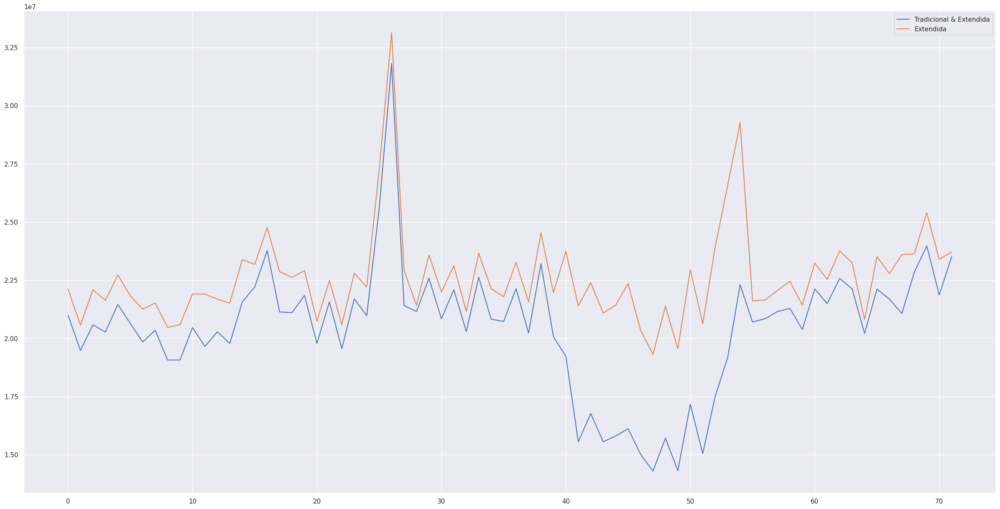

In [53]:
aux1 = df4[( df4['promo'] == 1 ) & ( df4['promo2'] == 1 )][['year_week','sales']].groupby( 'year_week' ).sum().reset_index()
ax = aux1.plot()

aux2 = df4[( df4['promo'] == 1 ) & ( df4['promo2'] == 0 )][['year_week','sales']].groupby( 'year_week' ).sum().reset_index()
aux2.plot( ax=ax )

ax.legend( labels=['Tradicional & Extendida', 'Extendida']);

### H8. Lojas abertas durante o feriado de Natal deveriam vender mais.
### ***FALSA*** Lojas abertas durante o feriado do natal vendem menos.

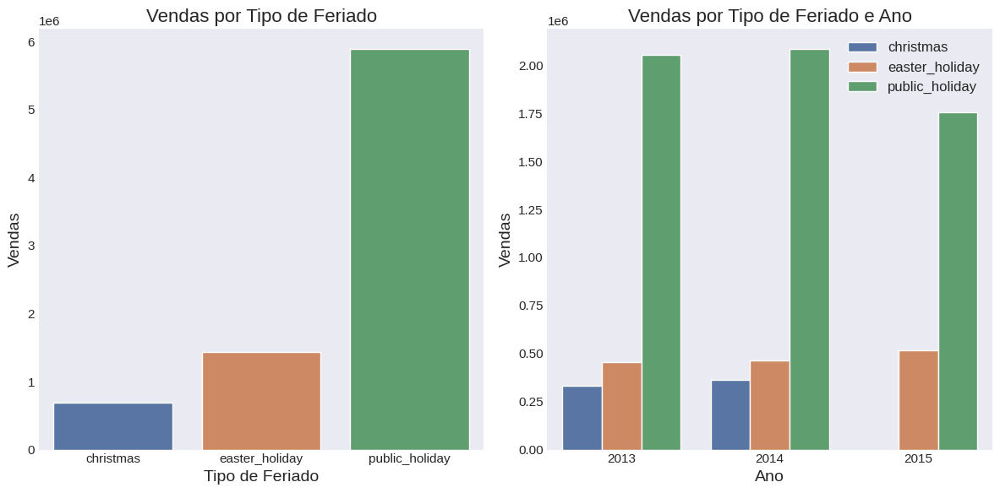

In [54]:
aux = df4[df4['state_holiday'] != 'regular_day']

plt.figure(figsize=(12,6))
plt.style.use('seaborn-dark')

plt.subplot( 1, 2, 1 )
aux1 = aux[['state_holiday', 'sales']].groupby( 'state_holiday' ).sum().reset_index()
sns.barplot( x='state_holiday', y='sales', data=aux1 )
plt.title('Vendas por Tipo de Feriado', fontsize=16)
plt.xlabel('Tipo de Feriado', fontsize=14)
plt.ylabel('Vendas', fontsize=14)

plt.subplot( 1, 2, 2 )
aux2 = aux[['year', 'state_holiday', 'sales']].groupby( ['year', 'state_holiday'] ).sum().reset_index()
sns.barplot( x='year' , y='sales', hue='state_holiday', data=aux2 )
plt.title('Vendas por Tipo de Feriado e Ano', fontsize=16)
plt.xlabel('Ano', fontsize=14)
plt.ylabel('Vendas', fontsize=14)
plt.legend(fontsize=12)

plt.tight_layout()
plt.show()


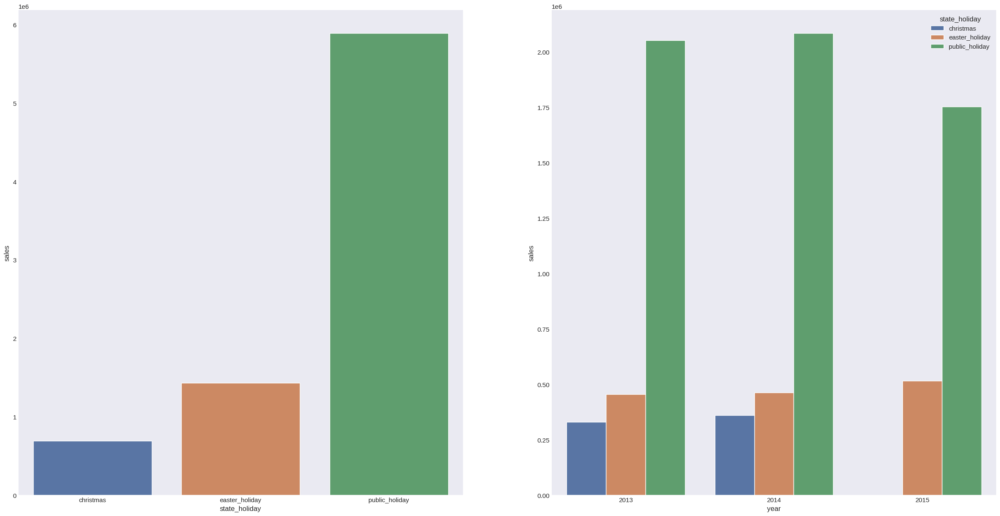

In [55]:
aux = df4[df4['state_holiday'] != 'regular_day']

plt.subplot( 1, 2, 1 )
aux1 = aux[['state_holiday', 'sales']].groupby( 'state_holiday' ).sum().reset_index()
sns.barplot( x='state_holiday', y='sales', data=aux1 );

plt.subplot( 1, 2, 2 )
aux2 = aux[['year', 'state_holiday', 'sales']].groupby( ['year', 'state_holiday'] ).sum().reset_index()
sns.barplot( x='year' , y='sales', hue='state_holiday', data=aux2 );

### H9. Lojas deveriam vender mais ao longo dos anos.
### ***FALSA*** Lojas vendem menos ao longo dos anos.

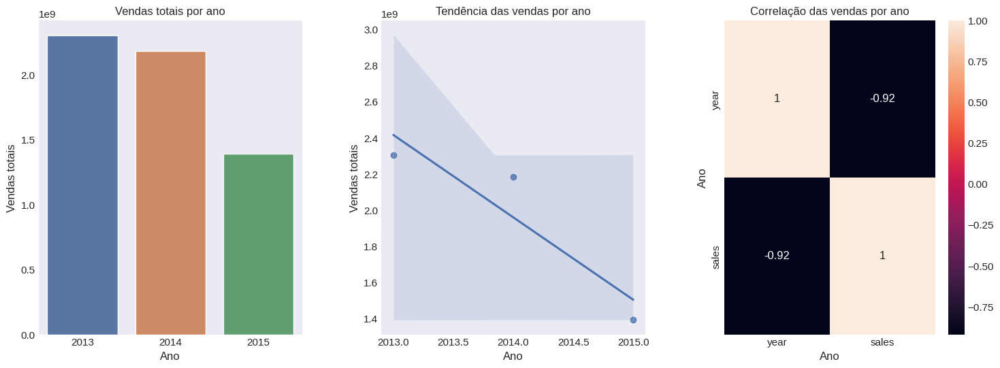

In [56]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Criação de um DataFrame auxiliar com as vendas totais por ano
aux1 = df4[['year', 'sales']].groupby('year').sum().reset_index()

# Configurações do gráfico
fig, axs = plt.subplots(ncols=3, figsize=(18, 6))
plt.subplots_adjust(wspace=0.3)

# Gráfico de barras mostrando as vendas totais por ano
sns.barplot(x='year', y='sales', data=aux1, ax=axs[0])
axs[0].set_xlabel('Ano')
axs[0].set_ylabel('Vendas totais')
axs[0].set_title('Vendas totais por ano')

# Gráfico de dispersão com a linha de tendência
sns.regplot(x='year', y='sales', data=aux1, ax=axs[1])
axs[1].set_xlabel('Ano')
axs[1].set_ylabel('Vendas totais')
axs[1].set_title('Tendência das vendas por ano')

# Mapa de calor da matriz de correlação
corr = aux1.corr(method='pearson')
sns.heatmap(corr, annot=True, ax=axs[2])
axs[2].set_xlabel('Ano')
axs[2].set_ylabel('Ano')
axs[2].set_title('Correlação das vendas por ano')

plt.show()

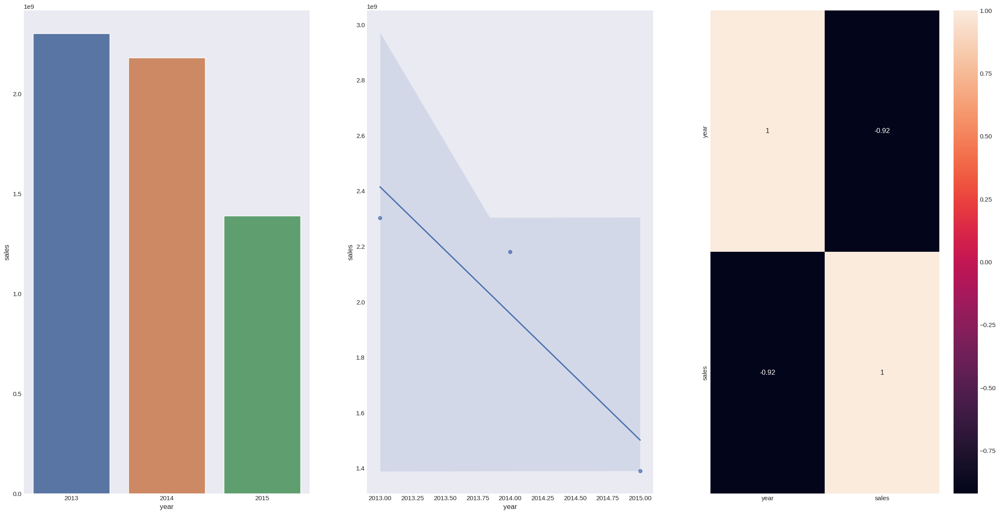

In [57]:
aux1 = df4[['year', 'sales']].groupby( 'year' ).sum().reset_index()

plt.subplot( 1, 3, 1 )
sns.barplot( x='year', y='sales', data=aux1 );

plt.subplot( 1, 3, 2 )
sns.regplot( x='year', y='sales', data=aux1 ); #Gráfico de tendêcia

plt.subplot( 1, 3, 3 )
sns.heatmap( aux1.corr( method='pearson' ), annot=True ); #Gráfico de correlação

### H10. Lojas deveriam vender mais no segundo semestre do ano.
### ***FALSA*** Lojas vendem menos no segundo semestre do ano.

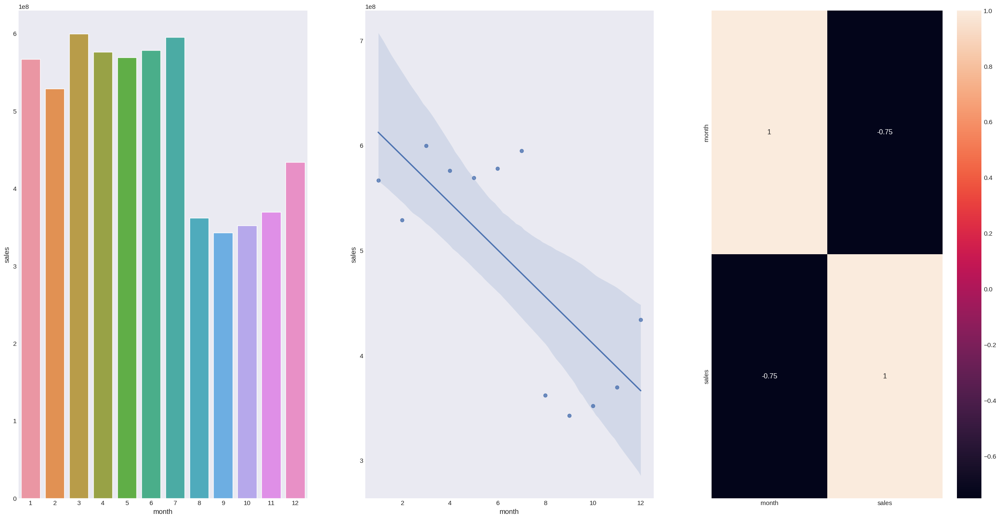

In [58]:
aux1 = df4[['month', 'sales']].groupby( 'month' ).sum().reset_index()

plt.subplot( 1, 3, 1 )
sns.barplot( x='month', y='sales', data=aux1 );

plt.subplot( 1, 3, 2 )
sns.regplot( x='month', y='sales', data=aux1 ); #Gráfico de tendêcia

plt.subplot( 1, 3, 3 )
sns.heatmap( aux1.corr( method='pearson' ), annot=True ); #Gráfico de correlação

### H11. Lojas deveriam vender mais depois do dia 10 de cada mês.
### ***VERDADEIRA*** Lojas vendem menos no segundo semestre do ano.

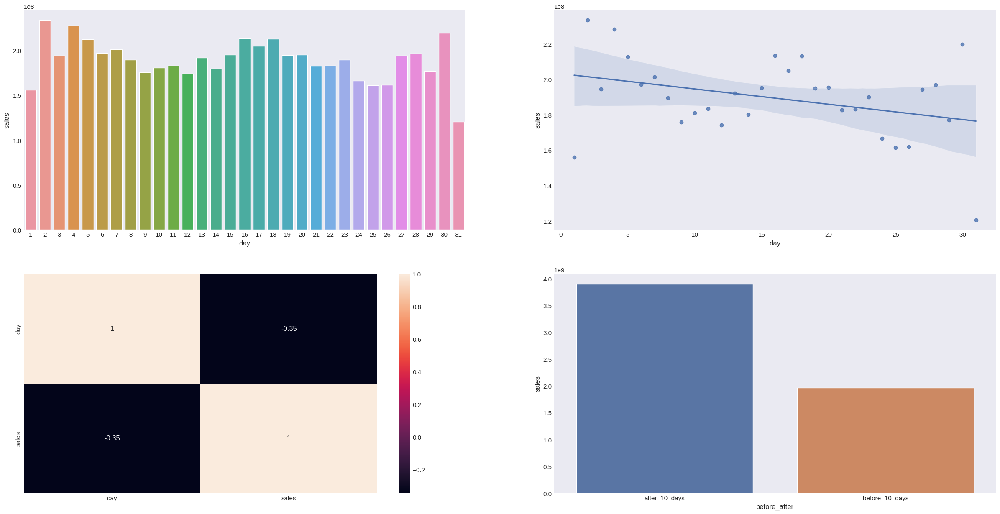

In [59]:
aux1 = df4[['day', 'sales']].groupby( 'day' ).sum().reset_index()

plt.subplot( 2, 2, 1 )
sns.barplot( x='day', y='sales', data=aux1 );

plt.subplot( 2, 2, 2 )
sns.regplot( x='day', y='sales', data=aux1 ); #Gráfico de tendêcia

plt.subplot( 2, 2, 3 )
sns.heatmap( aux1.corr( method='pearson' ), annot=True ); #Gráfico de correlação

aux1['before_after'] = aux1['day'].apply( lambda x: 'before_10_days' if x <= 10 else 'after_10_days' )
aux2 = aux1[['before_after', 'sales']].groupby( 'before_after' ).sum().reset_index()

plt.subplot( 2, 2, 4 )
sns.barplot( x='before_after', y='sales', data=aux2 );

### H12. Lojas deveriam vender menos aos finais de semana.
### ***VERDADEIRA*** Lojas vendem menos nos finais de semana.

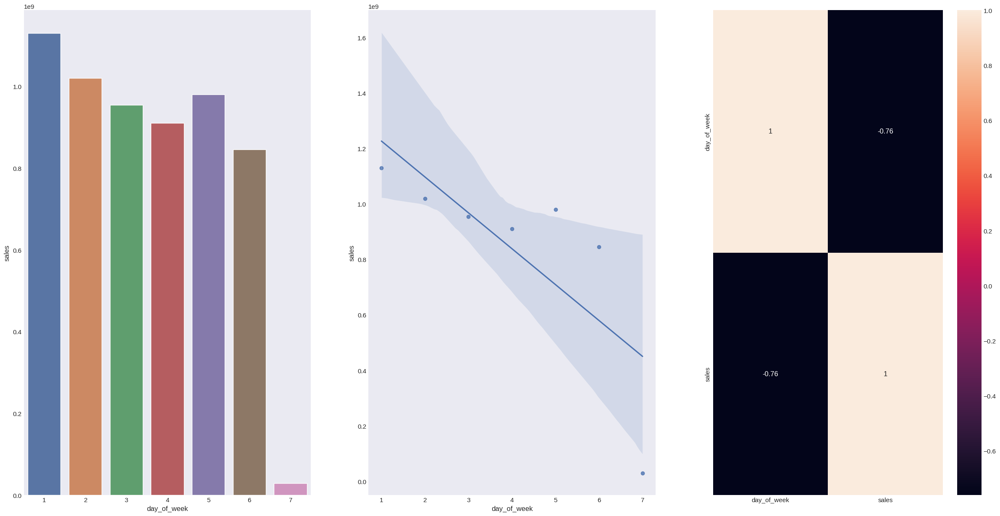

In [60]:
aux1 = df4[['day_of_week', 'sales']].groupby( 'day_of_week' ).sum().reset_index()

plt.subplot( 1, 3, 1 )
sns.barplot( x='day_of_week', y='sales', data=aux1 );

plt.subplot( 1, 3, 2 )
sns.regplot( x='day_of_week', y='sales', data=aux1 ); #Gráfico de tendêcia

plt.subplot( 1, 3, 3 )
sns.heatmap( aux1.corr( method='pearson' ), annot=True ); #Gráfico de correlação

### H13. Lojas deveriam vender menos durante os feriados escolares.
### ***VERDADEIRA*** Lojas vendem menos durante os feriados escolares, exceto os meses de julho e agosto.

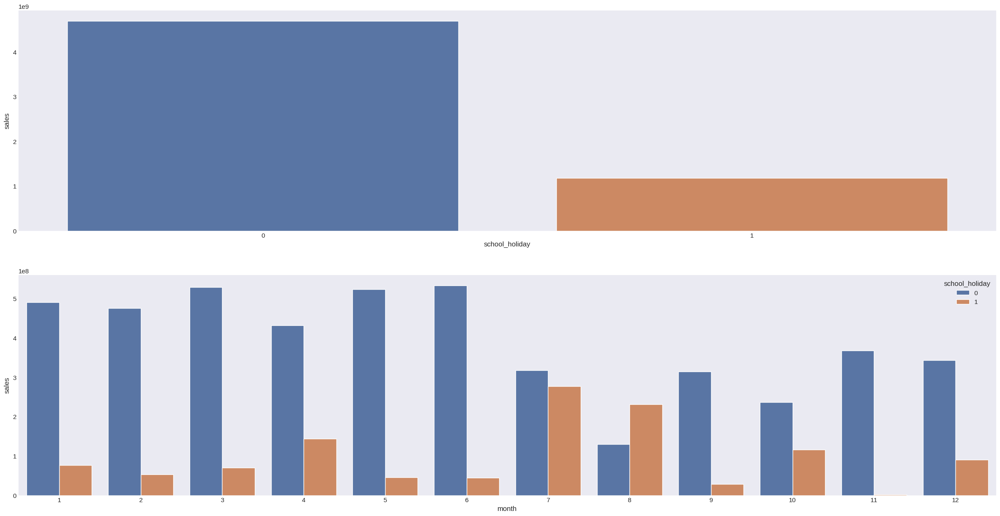

In [61]:
aux1 = df4[[ 'school_holiday', 'sales']].groupby( 'school_holiday' ).sum().reset_index()

plt.subplot( 2, 1, 1 )
sns.barplot( x='school_holiday', y='sales', data=aux1 );

plt.subplot( 2, 1, 2 )
aux2 = df4[['month', 'school_holiday', 'sales']].groupby( ['month','school_holiday'] ).sum().reset_index()
sns.barplot( x='month', y='sales', hue='school_holiday', data=aux2 );

## 4.2.1. Resumo das hipóteses

In [62]:
from tabulate import tabulate

In [64]:
tab=[[' Hipoteses', 'Conclusao', 'Relevancia'],
     ['H1', 'Falsa', 'Baixa'],
     ['H2', 'Falsa', 'Media'],
     ['H3', 'Falsa', 'Media'],
     ['H4', 'Falsa', 'Baixa'],
     ['H5', '_', '_'],
     ['H7', 'Falsa', 'Baixa'],
     ['H8', 'Falsa', 'Media'],
     ['H9', 'Falsa', 'Alta'],
     ['H10', 'Falsa', 'Alta'],
     ['H11', 'Verdadeira', 'Alta'],
     ['H12', 'Verdadeira', 'Alta'],
     ['H13', 'Verdadeira', 'Baixa'],
    ]
print( tabulate( tab, headers='firstrow' ) )

 Hipoteses    Conclusao    Relevancia
------------  -----------  ------------
H1            Falsa        Baixa
H2            Falsa        Media
H3            Falsa        Media
H4            Falsa        Baixa
H5            _            _
H7            Falsa        Baixa
H8            Falsa        Media
H9            Falsa        Alta
H10           Falsa        Alta
H11           Verdadeira   Alta
H12           Verdadeira   Alta
H13           Verdadeira   Baixa


## 4.3. ANALISE MULTIVARIADA  ( Encontrar as correlações entre as próprias variáveis )

### 4.3.1 Numerical Attributes ( Variáveis numéricas -> método de Pearson )

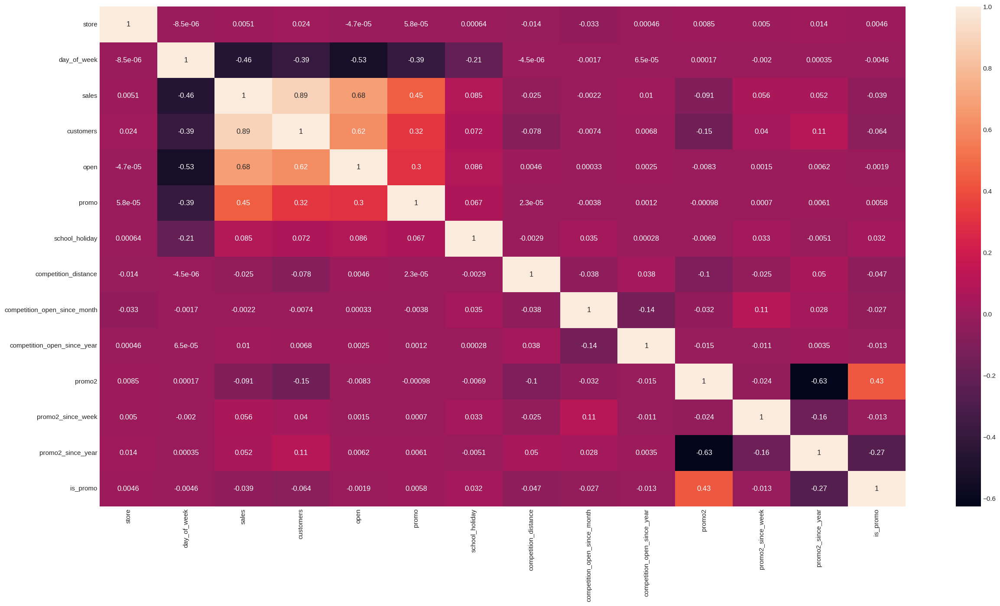

In [65]:
correlation = num_attributes.corr( method='pearson' )
sns.heatmap( correlation, annot=True );

### 4.3.1 Categorical Attributes ( Variáveis Categóricas -> método V de Cramer )

<Axes: >

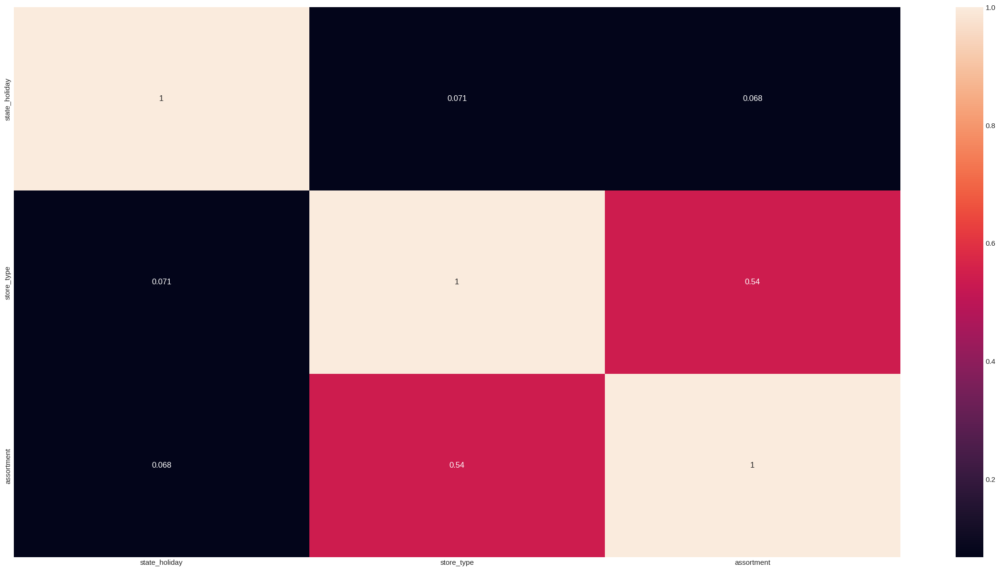

In [66]:
# only categorical data
a = df4.select_dtypes( include='object' )

# Calculate cramer V
a1 = cramer_v(a['state_holiday'], a['state_holiday'] ) 
a2 = cramer_v(a['state_holiday'], a['store_type'] ) 
a3 = cramer_v(a['state_holiday'], a['assortment'] )

a4 = cramer_v(a['store_type'], a['state_holiday'] )
a5 = cramer_v(a['store_type'], a['store_type'] )
a6 = cramer_v(a['store_type'], a['assortment'] )

a7 = cramer_v(a['assortment'], a['state_holiday'] )
a8 = cramer_v(a['assortment'], a['store_type'] )
a9 = cramer_v(a['assortment'], a['assortment'] )

# Final dataset
d = pd.DataFrame( {'state_holiday': [a1, a2, a3], 
               'store_type': [a4, a5, a6], 
               'assortment': [a7, a8, a9] })

d = d.set_index( d.columns )

sns.heatmap( d, annot=True )

# 5.0. PASSO 05 - DATA PREPARATION

In [67]:
df5 = df4.copy()

## 5.1. Normalização

## 5.2. Rescaling ( Normalizando os ranges  )

In [68]:
rs = RobustScaler() # Aplicado em variáveis com Outliers fortes
mms = MinMaxScaler() # Aplicado em variáveis sem Outliers fortes

# competition distance
df5['competition_distance'] = rs.fit_transform( df5[['competition_distance']].values )

# competition time month
df5['competition_time_month'] = rs.fit_transform( df5[['competition_time_month']].values )

# promo time week
df5['promo_time_week'] = mms.fit_transform( df5[['promo_time_week']].values )

# year
df5['year'] = mms.fit_transform( df5[['year']].values )

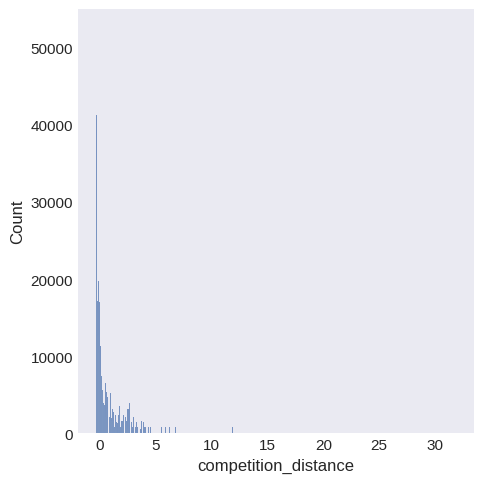

In [69]:
sns.displot( df5['competition_distance'] )

## 5.3. Transformação

### 5.3.1. Enconding

In [70]:
# state_holiday ( One Hot Enconding )
df5 = pd.get_dummies( df5, prefix=['state_holiday'], columns=['state_holiday'] )

# store_type ( Label Encoding )
le = LabelEncoder()
df5['store_type'] = le.fit_transform( df5['store_type'] )

# assortment ( Ordinal Encoding )
assortment_dict = {'basic': 1, 'extra': 2, 'extended': 3}
df5['assortment'] = df5['assortment'].map( assortment_dict )

### 5.3.2. Response Variable Transformation

In [71]:
df5['sales'] = np.log1p(df5['sales'] )

<Axes: xlabel='sales', ylabel='Density'>

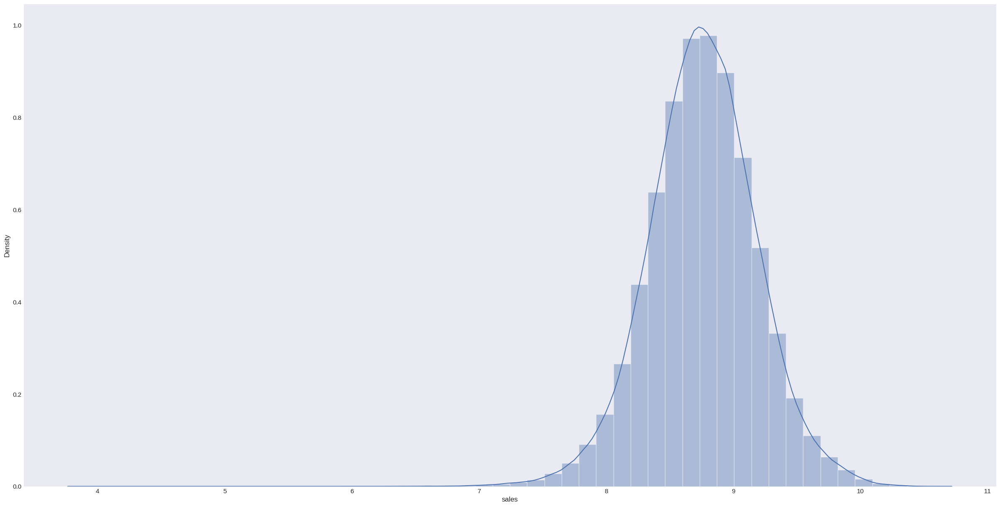

In [72]:
sns.distplot( df5['sales'] )

### 5.3.3. Nature Transformation ( Natureza Cíclica )

In [73]:
# month
df5['month_sin'] = df5['month'].apply( lambda x: np.sin( x* ( 2. * np.pi/12 ) ) )
df5['month_cos'] = df5['month'].apply( lambda x: np.cos( x* ( 2. * np.pi/12 ) ) )

# day
df5['day_sin'] = df5['day'].apply( lambda x: np.sin( x* ( 2. * np.pi/30 ) ) )
df5['day_cos'] = df5['day'].apply( lambda x: np.cos( x* ( 2. * np.pi/30 ) ) )

# week of year
df5['week_of_year_sin'] = df5['week_of_year'].apply( lambda x: np.sin( x* ( 2. * np.pi/52 ) ) )
df5['week_of_year_cos'] = df5['week_of_year'].apply( lambda x: np.cos( x* ( 2. * np.pi/52 ) ) )

# day of week
df5['day_of_week_sin'] = df5['day_of_week'].apply( lambda x: np.sin( x* ( 2. * np.pi/7 ) ) )
df5['day_of_week_cos'] = df5['day_of_week'].apply( lambda x: np.cos( x* ( 2. * np.pi/7 ) ) )

# 6.0. PASSO 06 - FEATURE SELECTION

In [74]:
df6 = df5.copy()

## 6.1. Split dataframe into training and test dataset

In [75]:
cols_drop = [ 'week_of_year', 'day', 'month', 'day_of_week', 'promo_since', 'competition_since', 'year_week' ]
df6 = df6.drop( cols_drop, axis=1 )

In [76]:
#df6[['store', 'date']].groupby( 'store' ).max().reset_index()['date'][0] - datetime.timedelta( days=6*7 )

In [77]:
# training dataset
X_train = df6[df6['date'] < '2015-06-19' ]
y_train = X_train['sales']

# test dataset
X_test = df6[df6['date'] >= '2015-06-19' ]
y_test = X_test['sales']

print( 'Training Min Date: {}'.format( X_train['date'].min() ) )
print( 'Training Max Date: {}'.format( X_train['date'].max() ) )

print( '\nTest Min Date: {}'.format( X_test['date'].min() ) )
print( 'Test Max Date: {}'.format( X_test['date'].max() ) )

Training Min Date: 2013-01-01 00:00:00
Training Max Date: 2015-06-18 00:00:00

Test Min Date: 2015-06-19 00:00:00
Test Max Date: 2015-07-31 00:00:00


## 6.2. Boruta as Feature Selection

In [78]:
## training and test dataset for Boruta
# X_train_n = X_train.drop( ['date', 'sales'], axis=1 ).values
# y_train_n = y_train.values.ravel()

## define RandomForestRegressor
# rf = RandomForestRegressor( n_jobs=-1)

## define Boruta
# boruta = BorutaPy( rf, n_estimators='auto', verbose=2, random_state=42 ).fit( X_train_n, y_train_n)

### 6.2.1. Best Features from Boruta

In [79]:
# cols_selected = boruta.support_.tolist()

## best features
# X_train_fs = X_train.drop( ['date', 'sales'], axis=1 )
# cols_selected_boruta = X_train_fs.iloc[:, cols_selected].columns.to_list()

# not selected boruta
# cols_not_selected_boruta = list( np.setdiff1d( X_train_fs.columns, cols_selected_boruta ) )

### 6.3. Manual Feature Selection

In [80]:
cols_selected_boruta = [
    'store',
    'promo',
    'store_type',
    'assortment',
    'competition_distance',
    'competition_open_since_month',
    'competition_open_since_year',
    'promo2',
    'promo2_since_week',
    'promo2_since_year',
    'competition_time_month',
    'promo_time_week',
    'month_sin',
    'month_cos',
    'day_sin',
    'day_cos',
    'week_of_year_sin',
    'week_of_year_cos',
    'day_of_week_sin',
    'day_of_week_cos']

# columns to add
feat_to_add = ['date', 'sales']

# final features

cols_selected_boruta_full = cols_selected_boruta.copy()
cols_selected_boruta_full.extend( feat_to_add )

# 7.0. PASSO 07 - MACHINE LEARNING MODELING

In [81]:
x_train = X_train[ cols_selected_boruta ]
x_test = X_test[ cols_selected_boruta ]

# Time Series Data Preparation
x_training = X_train[ cols_selected_boruta_full ] # todas as variáveis relevantes + date + sales

## 7.1. Average Model

In [82]:
aux1 = x_test.copy()
aux1['sales'] = y_test.copy()

# prediction
aux2 = aux1[['store', 'sales']].groupby( 'store' ).mean().reset_index().rename( columns={'sales': 'predictions'} )
aux1 = pd.merge( aux1, aux2, how='left', on='store' )
yhat_baseline = aux1['predictions']

# performance
baseline_result = ml_error( 'Average Model', np.expm1( y_test ), np.expm1( yhat_baseline ) )
baseline_result

,Model Name,MAE,MAPE,RMSE
0,Average Model,1354.800353,0.455051,1835.135542


## 7.2. Linear Regression Model

In [83]:
# model
lr = LinearRegression().fit( x_train, y_train )

# prediction
yhat_lr = lr.predict( x_test )

# performance
lr_result = ml_error( 'Linear Regression', np.expm1( y_test ), np.expm1( yhat_lr ) )
lr_result

,Model Name,MAE,MAPE,RMSE
0,Linear Regression,1867.089774,0.292694,2671.049215


### 7.2.1. Linear Regression Model - Cross Validation

---



In [84]:
lr_result_cv = cross_validation( x_training, 5, 'Linear Regression', lr )
lr_result_cv

,Model Name,MAE CV,MAPE CV,RMSE CV
0,Linear Regression,2081.73 +/- 295.63,0.3 +/- 0.02,2952.52 +/- 468.37


## 7.3. Linear Regression Regularized Model - Lasso

In [85]:
# model
lrr = Lasso( alpha=0.01 ).fit( x_train, y_train )

# prediction
yhat_lrr = lrr.predict( x_test )

# performance
lrr_result = ml_error( 'Linear Regression - Lasso', np.expm1( y_test ), np.expm1( yhat_lrr ) )
lrr_result

,Model Name,MAE,MAPE,RMSE
0,Linear Regression - Lasso,1891.70488,0.289106,2744.451735


### 7.3.1. Lasso - Cross Validation


In [86]:
lrr_result_cv = cross_validation( x_training, 5, 'Lasso', lrr )
lrr_result_cv

,Model Name,MAE CV,MAPE CV,RMSE CV
0,Lasso,2116.38 +/- 341.5,0.29 +/- 0.01,3057.75 +/- 504.26


## 7.4. Random Forest Regressor

In [87]:
# model
rf = RandomForestRegressor( n_estimators=100, n_jobs=-1, random_state=42 ).fit( x_train, y_train )

# prediction
yhat_rf = rf.predict( x_test )

# performance
rf_result = ml_error( 'Random Forest Regressor', np.expm1( y_test ), np.expm1( yhat_rf ) )
rf_result

,Model Name,MAE,MAPE,RMSE
0,Random Forest Regressor,679.098387,0.099882,1009.869873


### 7.4.1. Random Forest Regressor Model - Cross Validation

In [88]:
rf_result_cv = cross_validation( x_training, 5, 'Random Forest Regressor', rf )
rf_result_cv

,Model Name,MAE CV,MAPE CV,RMSE CV
0,Random Forest Regressor,837.47 +/- 218.61,0.12 +/- 0.02,1257.22 +/- 319.82


## 7.5. XGBoost Regressor

In [141]:
# XGBoost Regressor
model_xgb = xgb.XGBRegressor( objective='reg:squarederror',
                              n_estimators=1000,
                              eta=0.1,
                              max_depth=5,
                              subsample=0.7,
                              colsample_bytree=0.7,
                              random_state=42 ).fit( x_train, y_train )

yhat_xgb = model_xgb.predict( x_test )

xgb_result = ml_error( 'XGBoost Regressor', np.expm1( y_test ), np.expm1( yhat_xgb ) )
print( xgb_result )


          Model Name        MAE      MAPE         RMSE
0  XGBoost Regressor  751.24659  0.113186  1077.071248


### 7.5.1. XGBoost Regressor Model - Cross Validation

In [142]:
xgb_result_cv = cross_validation( x_training, 5, 'XGBoost Regressor', model_xgb )
xgb_result_cv

,Model Name,MAE CV,MAPE CV,RMSE CV
0,XGBoost Regressor,928.15 +/- 129.72,0.13 +/- 0.01,1322.73 +/- 176.6


## 7.6. Compare Model's Performance

### 7.6.1. Single Performance

In [143]:
modelling_result = pd.concat( [baseline_result, lr_result, lrr_result, rf_result, xgb_result] )
modelling_result.sort_values( 'RMSE' )

,Model Name,MAE,MAPE,RMSE
0,Random Forest Regressor,679.098387,0.099882,1009.869873
0,XGBoost Regressor,751.246590,0.113186,1077.071248
0,Average Model,1354.800353,0.455051,1835.135542
0,Linear Regression,1867.089774,0.292694,2671.049215
0,Linear Regression - Lasso,1891.704880,0.289106,2744.451735


### 7.6.1. Real Performance - Cross Validation

In [144]:
modelling_result_cv = pd.concat( [lr_result_cv, lrr_result_cv, rf_result_cv, xgb_result_cv] )
modelling_result_cv

,Model Name,MAE CV,MAPE CV,RMSE CV
0,Linear Regression,2081.73 +/- 295.63,0.3 +/- 0.02,2952.52 +/- 468.37
0,Lasso,2116.38 +/- 341.5,0.29 +/- 0.01,3057.75 +/- 504.26
0,Random Forest Regressor,837.47 +/- 218.61,0.12 +/- 0.02,1257.22 +/- 319.82
0,XGBoost Regressor,928.15 +/- 129.72,0.13 +/- 0.01,1322.73 +/- 176.6


# 8.0. PASSO 08 - HYPERPARAMETER FINE TUNING

## 8.1. Random Search ( rodando em 8h )

In [145]:
#param = {
#    'n_estimators': [1500, 1700, 2500, 3000, 3500],
#    'eta': [0.05, 0.01, 0.03],
#    'max_depth': [3, 5, 9],
#    'subsample': [0.1, 0.5, 0.7, 0.8],
#    'colsample_bytee': [0.3, 0.7, 0.9],
#    'min_child_weight': [3, 5, 8, 15]
#         }
#MAX_EVAL = 5

In [146]:
#final_result = pd.DataFrame()
#
#for i in range( MAX_EVAL ):
#    # choose values for parameters randomly
#    hp = { k: np.random.choice( v, 1 )[0] for k, v in param.items() }
#    print( hp )
#
#    # model
#    model_xgb = xgb.XGBRegressor( objective='reg:squarederror',
#                                n_estimators=hp['n_estimators'],
#                                eta=hp['eta'],
#                                max_depth=hp['max_depth'],
#                                subsample=hp['subsample'],
#                                colsample_bytee=hp['colsample_bytee'],
#                                min_child_weight=hp['min_child_weight'] )
#    
#    # performance
#    result = cross_validation( x_training, 2, 'XGBoost Regressor', model_xgb, verbose=False )
#    final_result = pd.concat( [final_result, result] )
#
#final_result

## 8.1. Final Model

In [147]:
param_tuned = {
    'n_estimators': 3500,
    'eta': 0.005,
    'max_depth': 9,
    'subsample': 0.8,
    'colsample_bytree': 0.7,
    'min_child_weight': 5,
    'random_state': 42,
             }

In [148]:
# model
model_xgb_tuned = xgb.XGBRegressor( objective='reg:squarederror',
                                    n_estimators=param_tuned['n_estimators'],
                                    eta=param_tuned['eta'],
                                    max_depth=param_tuned['max_depth'],
                                    subsample=param_tuned['subsample'],
                                    colsample_bytree=param_tuned['colsample_bytree'],
                                    min_child_weight=param_tuned['min_child_weight'], 
                                    random_state=param_tuned['random_state'] ).fit( x_train, y_train )

# prediction
yhat_xgb_tuned = model_xgb_tuned.predict( x_test )
    
# performance
xgb_result_tuned = ml_error( 'XGBoost Regressor', np.expm1( y_test ), np.expm1( yhat_xgb_tuned ) )
xgb_result_tuned

,Model Name,MAE,MAPE,RMSE
0,XGBoost Regressor,775.156519,0.114113,1132.319847


In [149]:
pickle.dump( model_xgb_tuned, open("/content/model_rossmann.pkl", 'wb' ) )
from google.colab import files
files.download('/content/model_rossmann.pkl') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [150]:
mpe = mean_percentage_error( np.expm1( y_test ), np.expm1( yhat_xgb_tuned ) )

In [151]:
mpe

-0.00907982632473737

# 9.0. PASSO 09 - TRADUÇÃO E INTERPRETEÇÃO DO ERRO

In [152]:
df9 = X_test[ cols_selected_boruta_full ]

# rescale
df9['sales'] = np.expm1( df9['sales'] )
df9['predictions'] = np.expm1( yhat_xgb_tuned  )

## 9.1. Business Performance

In [153]:
# sum of predictions
df91 = df9[['store', 'predictions']].groupby('store' ).sum().reset_index()

# MAE and MAPE
df9_aux1 = df9[['store', 'sales', 'predictions']].groupby( 'store' ).apply( lambda x: mean_absolute_error( x['sales'], x['predictions'] ) ).reset_index().rename(columns={0:'MAE'} )
df9_aux2 = df9[['store', 'sales', 'predictions']].groupby( 'store' ).apply( lambda x: mean_absolute_percentage_error( x['sales'], x['predictions'] ) ).reset_index().rename(columns={0:'MAPE'} )

# Merge
df9_aux3 = pd.merge( df9_aux1, df9_aux2, how='inner', on='store' )
df92 = pd.merge( df91, df9_aux3, how='inner', on='store' )

# Scenarios
df92['worst_scenario'] = df92['predictions'] - df92['MAE']
df92['best_scenario'] = df92['predictions'] + df92['MAE']

# order columns
df92 = df92[[ 'store', 'predictions', 'worst_scenario', 'best_scenario', 'MAE', 'MAPE']]

In [154]:
df92.sample(10)

,store,predictions,worst_scenario,best_scenario,MAE,MAPE
448,449,381119.875000,380144.519056,382095.230944,975.355944,0.091238
309,310,306934.250000,305350.536099,308517.963901,1583.713901,0.172588
1034,1035,183998.671875,183571.777001,184425.566749,426.894874,0.096510
638,639,180103.953125,179412.689915,180795.216335,691.263210,0.173709
136,137,292743.531250,291972.993164,293514.069336,770.538086,0.107160
917,918,204054.359375,203468.809016,204639.909734,585.550359,0.132570
380,381,314565.968750,313894.071619,315237.865881,671.897131,0.075301
112,113,234897.562500,234283.512999,235511.612001,614.049501,0.114644
394,395,161306.718750,160754.211327,161859.226173,552.507423,0.151881
150,151,257890.296875,257376.317409,258404.276341,513.979466,0.071088


In [155]:
df92.sort_values( 'MAPE', ascending=False ).head()

,store,predictions,worst_scenario,best_scenario,MAE,MAPE
291,292,111192.921875,107684.256219,114701.587531,3508.665656,0.640044
908,909,221007.890625,213136.024584,228879.756666,7871.866041,0.517736
285,286,177835.609375,176716.998350,178954.220400,1118.611025,0.398606
424,425,157305.312500,156217.601444,158393.023556,1087.711056,0.378163
901,902,199823.593750,198420.469542,201226.717958,1403.124208,0.352660


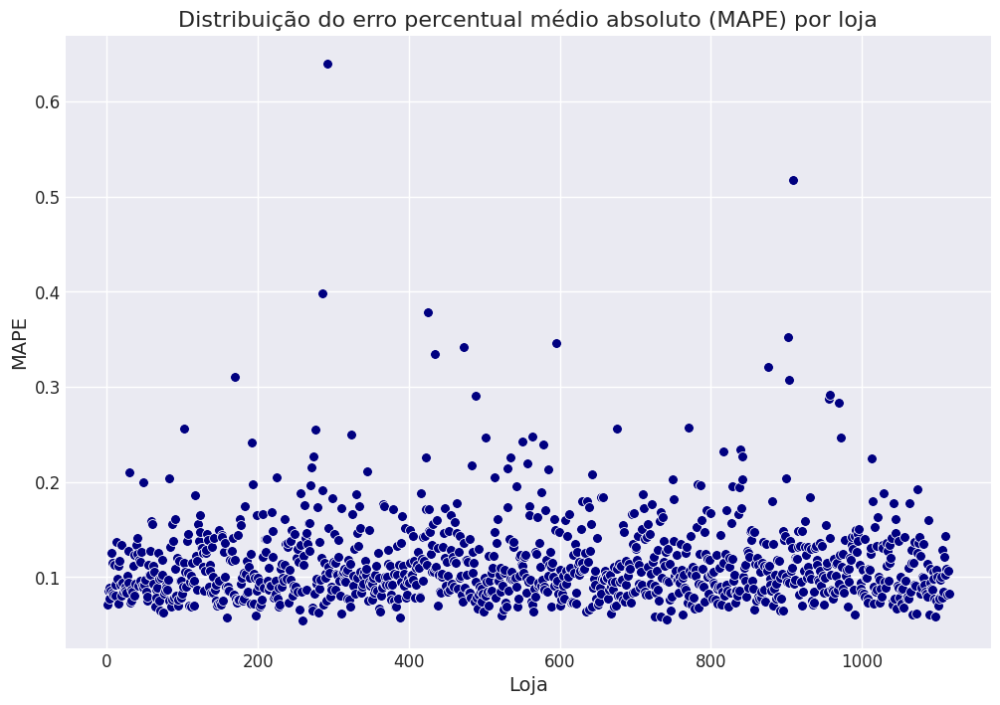

In [156]:
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_style('darkgrid')
plt.figure(figsize=(12, 8))
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

sns.scatterplot(x='store', y='MAPE', data=df92, color='navy', s=50)

plt.xlabel('Loja', fontsize=14)
plt.ylabel('MAPE', fontsize=14)
plt.title('Distribuição do erro percentual médio absoluto (MAPE) por loja', fontsize=16)

plt.show()


<Axes: xlabel='store', ylabel='MAPE'>

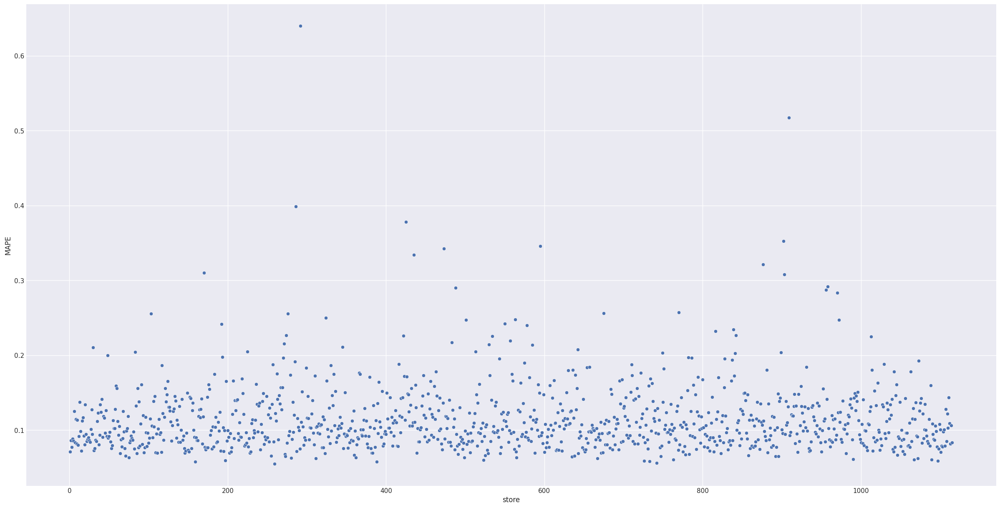

In [157]:
sns.scatterplot( x='store', y='MAPE', data=df92 )

## 9.2. Total Performance

In [158]:
df93 = df92[['predictions', 'worst_scenario', 'best_scenario']].apply( lambda x: np.sum( x ), axis=0 ).reset_index().rename( columns={'index': 'Scenario', 0: 'Values'} )
df93['Values'] = df93['Values'].map( 'R${:,.2f}'.format )
df93

,Scenario,Values
0,predictions,"R$282,423,488.00"
1,worst_scenario,"R$281,556,067.09"
2,best_scenario,"R$283,290,932.74"


## 9.3. Machine Learning Performance

In [159]:
df9['error'] = df9['sales'] - df9['predictions']
df9['error_rate'] = df9['predictions'] / df9['sales']

Text(0.5, 1.0, 'Erro vs. Predições')

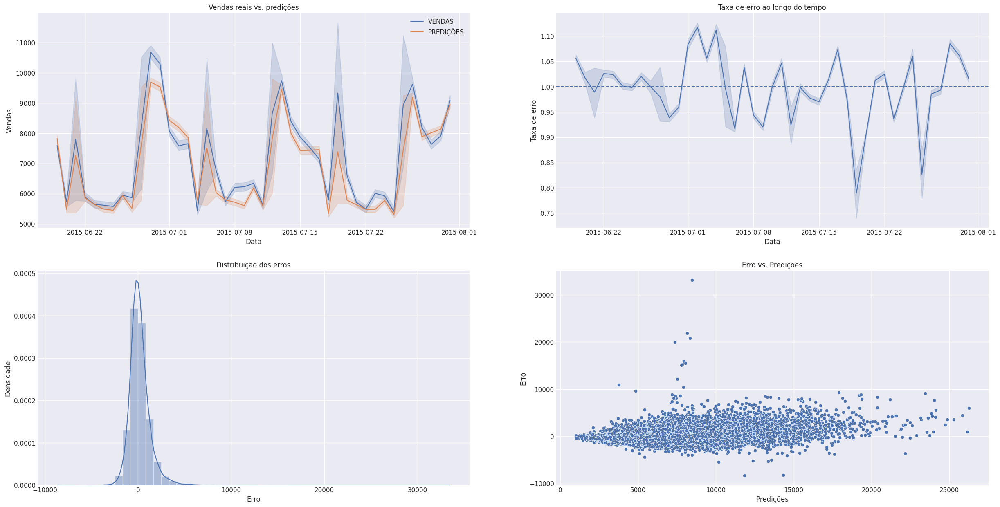

In [160]:
plt.subplot( 2, 2, 1 )
sns.lineplot( x='date', y='sales', data=df9, label='VENDAS' )
sns.lineplot( x='date', y='predictions', data=df9, label='PREDIÇÕES' )
plt.xlabel('Data')
plt.ylabel('Vendas')
plt.title('Vendas reais vs. predições')

plt.subplot( 2, 2, 2 )
sns.lineplot( x='date', y='error_rate', data=df9 )
plt.axhline( 1, linestyle='--' )
plt.xlabel('Data')
plt.ylabel('Taxa de erro')
plt.title('Taxa de erro ao longo do tempo')

plt.subplot( 2, 2, 3 )
sns.distplot( df9['error'] )
plt.xlabel('Erro')
plt.ylabel('Densidade')
plt.title('Distribuição dos erros')

plt.subplot( 2, 2, 4 )
sns.scatterplot(x=df9['predictions'], y=df9['error'])
plt.xlabel('Predições')
plt.ylabel('Erro')
plt.title('Erro vs. Predições')

<Figure size 3000x1500 with 0 Axes>

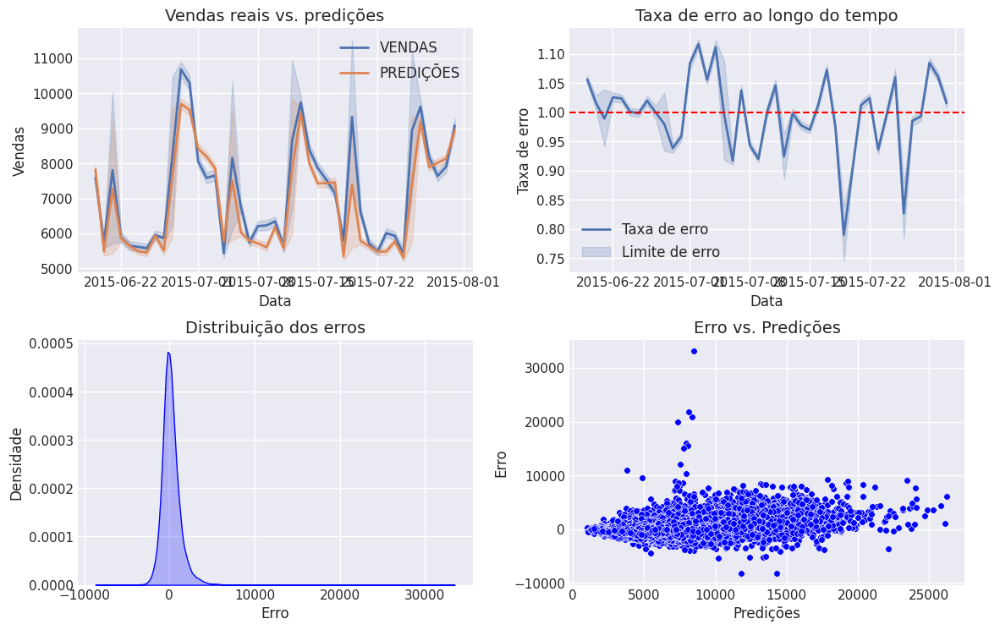

In [161]:
# Adicionando fonte e tamanho do título
plt.suptitle('Análise de desempenho do modelo de previsão', fontsize=16, fontweight='bold', y=1.05)

# Criando subplots e aumentando o tamanho das legendas
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(12, 8))
axs[0, 0].set_title('Vendas reais vs. predições', fontsize=14)
sns.lineplot(x='date', y='sales', data=df9, label='VENDAS', ax=axs[0, 0], linewidth=2)
sns.lineplot(x='date', y='predictions', data=df9, label='PREDIÇÕES', ax=axs[0, 0], linewidth=2)
axs[0, 0].set_xlabel('Data', fontsize=12)
axs[0, 0].set_ylabel('Vendas', fontsize=12)
axs[0, 0].legend(fontsize=12)

axs[0, 1].set_title('Taxa de erro ao longo do tempo', fontsize=14)
sns.lineplot(x='date', y='error_rate', data=df9, ax=axs[0, 1], linewidth=2)
axs[0, 1].set_xlabel('Data', fontsize=12)
axs[0, 1].set_ylabel('Taxa de erro', fontsize=12)
axs[0, 1].axhline(1, linestyle='--', color='red', linewidth=1.5)
axs[0, 1].legend(['Taxa de erro', 'Limite de erro'], fontsize=12)

axs[1, 0].set_title('Distribuição dos erros', fontsize=14)
sns.kdeplot(data=df9, x='error', ax=axs[1, 0], shade=True, color='blue')
axs[1, 0].set_xlabel('Erro', fontsize=12)
axs[1, 0].set_ylabel('Densidade', fontsize=12)

axs[1, 1].set_title('Erro vs. Predições', fontsize=14)
sns.scatterplot(x='predictions', y='error', data=df9, ax=axs[1, 1], color='blue', s=30)
axs[1, 1].set_xlabel('Predições', fontsize=12)
axs[1, 1].set_ylabel('Erro', fontsize=12)

# Ajustando o layout
plt.tight_layout()
plt.subplots_adjust(top=0.9)
plt.show()


<Figure size 3000x1500 with 0 Axes>

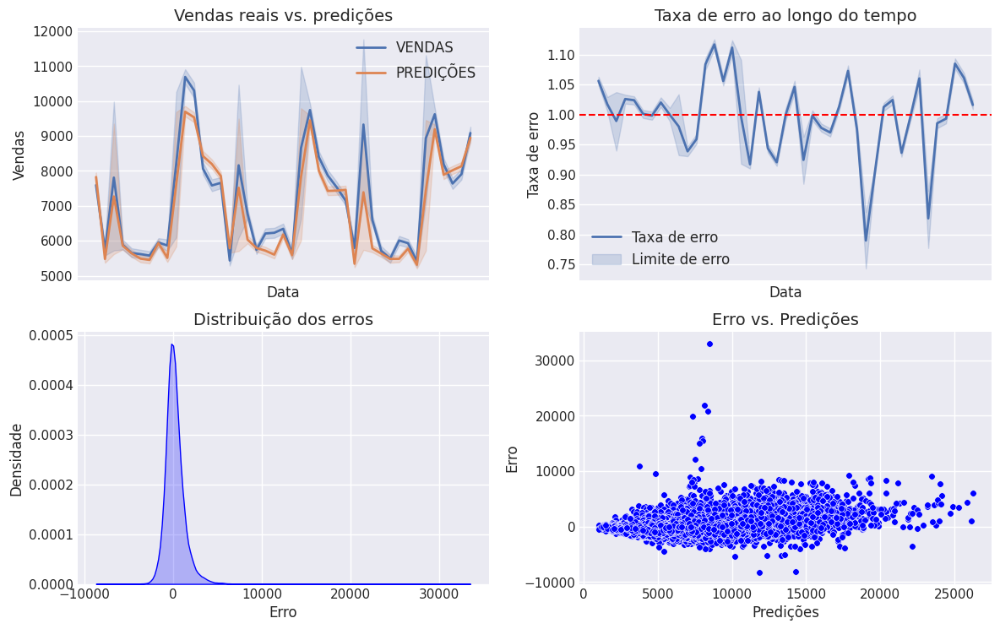

In [162]:
import matplotlib.dates as mdates

# Adicionando fonte e tamanho do título
plt.suptitle('Análise de desempenho do modelo de previsão', fontsize=16, fontweight='bold', y=1.05)

# Criando subplots e aumentando o tamanho das legendas
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(12, 8))
axs[0, 0].set_title('Vendas reais vs. predições', fontsize=14)
sns.lineplot(x='date', y='sales', data=df9, label='VENDAS', ax=axs[0, 0], linewidth=2)
sns.lineplot(x='date', y='predictions', data=df9, label='PREDIÇÕES', ax=axs[0, 0], linewidth=2)
axs[0, 0].set_xlabel('Data', fontsize=12)
axs[0, 0].set_ylabel('Vendas', fontsize=12)
axs[0, 0].legend(fontsize=12)
axs[0, 0].xaxis.set_major_locator(mdates.YearLocator())
axs[0, 0].xaxis.set_major_formatter(mdates.DateFormatter('%Y'))

axs[0, 1].set_title('Taxa de erro ao longo do tempo', fontsize=14)
sns.lineplot(x='date', y='error_rate', data=df9, ax=axs[0, 1], linewidth=2)
axs[0, 1].set_xlabel('Data', fontsize=12)
axs[0, 1].set_ylabel('Taxa de erro', fontsize=12)
axs[0, 1].axhline(1, linestyle='--', color='red', linewidth=1.5)
axs[0, 1].legend(['Taxa de erro', 'Limite de erro'], fontsize=12)
axs[0, 1].xaxis.set_major_locator(mdates.YearLocator())
axs[0, 1].xaxis.set_major_formatter(mdates.DateFormatter('%Y'))

axs[1, 0].set_title('Distribuição dos erros', fontsize=14)
sns.kdeplot(data=df9, x='error', ax=axs[1, 0], shade=True, color='blue')
axs[1, 0].set_xlabel('Erro', fontsize=12)
axs[1, 0].set_ylabel('Densidade', fontsize=12)

axs[1, 1].set_title('Erro vs. Predições', fontsize=14)
sns.scatterplot(x='predictions', y='error', data=df9, ax=axs[1, 1], color='blue', s=30)
axs[1, 1].set_xlabel('Predições', fontsize=12)
axs[1, 1].set_ylabel('Erro', fontsize=12)

# Ajustando o layout
plt.tight_layout()
plt.subplots_adjust(top=0.9)
plt.show()


# 10.0. PASSO 10 - DEPLOY MODEL TO PRODUCTION

In [163]:
pip freeze > requirements.txt

In [164]:
# Saving Trained Model
pickle.dump( model_xgb_tuned, open("/content/Rossmann_Store_Sales/Model trained/model_rossmann.pkl", 'wb' ) )

#from google.colab import files
#files.download('/content/model_rossmann.pkl') 

## 10.1. Rossmann Class

In [165]:
import pickle
import pandas as pd
import inflection
import numpy as np
import math
import datetime

class Rossmann( object ):
    def __init__( self ):
        self.home_path='/home/ricardo/repos/Rossmann_Store_Sales/Parameter/'
        self.competition_distance_scaler      = pickle.load( open( self.home_path + 'Parameter/competition_distance_scaler.pkl', 'rb') )
        self.promo_time_week_scaler           = pickle.load( open( self.home_path + 'Parameter/promo_time_week_scaler.pkl','rb') )
        self.competition_time_month_scaler    = pickle.load( open( self.home_path + 'Parameter/competition_time_month_scaler.pkl','rb') )
        self.year_scaler                      = pickle.load( open( self.home_path + 'Parameter/year_scaler.pkl','rb') )
        self.store_type_scaler                = pickle.load( open( self.home_path + 'Parameter/store_type_scaler.pkl','rb') )
          
        

    def data_cleaning( self, df1 ):

        ## 1.1. Rename Columns

        cols_old = ['Store', 'DayOfWeek', 'Date', 'Open', 'Promo', 'StateHoliday', 'SchoolHoliday', 
                    'StoreType', 'Assortment', 'CompetitionDistance', 'CompetitionOpenSinceMonth',
                    'CompetitionOpenSinceYear', 'Promo2', 'Promo2SinceWeek', 'Promo2SinceYear', 'PromoInterval']

        snakecase = lambda x: inflection.underscore( x )

        cols_new = list( map( snakecase, cols_old ) )

        # rename
        df1.columns = cols_new

        ## 1.3. Data Types
        df1['date'] = pd.to_datetime( df1['date'] )

        ## 1.5. Fillout NA
        #competition_distance        
        df1['competition_distance'] = df1['competition_distance'].apply( lambda x: 200000.0 if math.isnan( x ) else x )

        #competition_open_since_month
        df1['competition_open_since_month'] = df1.apply( lambda x: x['date'].month if math.isnan( x['competition_open_since_month'] ) else x['competition_open_since_month'], axis=1 )

        #competition_open_since_year 
        df1['competition_open_since_year'] = df1.apply( lambda x: x['date'].year if math.isnan( x['competition_open_since_year'] ) else x['competition_open_since_year'], axis=1 )

        #promo2_since_week           
        df1['promo2_since_week'] = df1.apply( lambda x: x['date'].week if math.isnan( x['promo2_since_week'] ) else x['promo2_since_week'], axis=1 )

        #promo2_since_year           
        df1['promo2_since_year'] = df1.apply( lambda x: x['date'].year if math.isnan( x['promo2_since_year'] ) else x['promo2_since_year'], axis=1 )

        #promo_interval              
        month_map = {1: 'Jan',  2: 'Fev',  3: 'Mar',  4: 'Apr',  5: 'May',  6: 'Jun',  7: 'Jul',  8: 'Aug',  9: 'Sep',  10: 'Oct', 11: 'Nov', 12: 'Dec'}

        df1['promo_interval'].fillna(0, inplace=True )

        df1['month_map'] = df1['date'].dt.month.map( month_map )

        df1['is_promo'] = df1[['promo_interval', 'month_map']].apply( lambda x: 0 if x['promo_interval'] == 0 else 1 if x['month_map'] in x['promo_interval'].split( ',' ) else 0, axis=1 )

        ## 1.6. Change Data Types
        # competiton
        df1['competition_open_since_month'] = df1['competition_open_since_month'].astype( int )
        df1['competition_open_since_year'] = df1['competition_open_since_year'].astype( int )
            
        # promo2
        df1['promo2_since_week'] = df1['promo2_since_week'].astype( int )
        df1['promo2_since_year'] = df1['promo2_since_year'].astype( int )

        return df1
    
    
    def feature_engineering( self, df2 ):

        # year
        df2['year'] = df2['date'].dt.year

        # month
        df2['month'] = df2['date'].dt.month

        # day
        df2['day'] = df2['date'].dt.day

        # week of year
        df2['week_of_year'] = df2['date'].dt.isocalendar().week 

        # year week
        df2['year_week'] = df2['date'].dt.strftime( '%Y-%W' )

        # competition since
        df2['competition_since'] = df2.apply( lambda x: datetime.datetime( year=x['competition_open_since_year'], month=x['competition_open_since_month'],day=1 ), axis=1 )
        df2['competition_time_month'] = ( ( df2['date'] - df2['competition_since'] )/30 ).apply( lambda x: x.days ).astype( int )

        # promo since
        df2['promo_since'] = df2['promo2_since_year'].astype( str ) + '-' + df2['promo2_since_week'].astype( str )
        df2['promo_since'] = df2['promo_since'].apply( lambda x: datetime.datetime.strptime( x + '-1', '%Y-%W-%w' ) - datetime.timedelta( days=7 ) )
        df2['promo_time_week'] = ( ( df2['date'] - df2['promo_since'] )/7 ).apply( lambda x: x.days ).astype( int )

        # assortment
        df2['assortment'] = df2['assortment'].apply( lambda x: 'basic' if x == 'a' else 'extra' if x == 'b' else 'extended' )

        # state holiday
        df2['state_holiday'] = df2['state_holiday'].apply( lambda x: 'public_holiday' if x == 'a' else 'easter_holiday' if x == 'b' else 'christmas' if x == 'c' else 'regular_day' )
        
        # 3.0. PASSO 03 - FILTRAGEM DE VARIÁVEIS
        ## 3.1. Filtragem das Linhas
        df2 = df2[(df2['open'] != 0)]

        ## 3.2. Selecao das Colunas
        cols_drop = [ 'open', 'promo_interval', 'month_map']
        df2 = df2.drop( cols_drop, axis=1 )

        return df2

    def data_preparation( self, df5, ft ):
        
        ## 5.2. Rescaling ( Normalizando os ranges  )
        # competition distance
        df5['competition_distance'] = self.competition_distance_scaler.fit_transform( df5[['competition_distance']].values )


        # competition time month
        df5['competition_time_month'] = self.competition_time_month_scaler.fit_transform( df5[['competition_time_month']].values )
        
        # promo time week
        df5['promo_time_week'] = self.promo_time_week_scaler.fit_transform( df5[['promo_time_week']].values )

        # year
        df5['year'] = self.year_scaler.fit_transform( df5[['year']].values )

        ### 5.3.1. Enconding
        # state_holiday ( One Hot Enconding )
        df5 = pd.get_dummies( df5, prefix=['state_holiday'], columns=['state_holiday'] )

        # store_type ( Label Encoding )
        df5['store_type'] = self.store_type_scaler.fit_transform( df5['store_type'] )


        # assortment ( Ordinal Encoding )
        assortment_dict = {'basic': 1, 'extra': 2, 'extended': 3}
        df5['assortment'] = df5['assortment'].map( assortment_dict )

        ### 5.3.3. Nature Transformation ( Natureza Cíclica )
        # month
        df5['month_sin'] = df5['month'].apply( lambda x: np.sin( x* ( 2. * np.pi/12 ) ) )
        df5['month_cos'] = df5['month'].apply( lambda x: np.cos( x* ( 2. * np.pi/12 ) ) )

        # day
        df5['day_sin'] = df5['day'].apply( lambda x: np.sin( x* ( 2. * np.pi/30 ) ) )
        df5['day_cos'] = df5['day'].apply( lambda x: np.cos( x* ( 2. * np.pi/30 ) ) )

        # week of year
        df5['week_of_year_sin'] = df5['week_of_year'].apply( lambda x: np.sin( x* ( 2. * np.pi/52 ) ) )
        df5['week_of_year_cos'] = df5['week_of_year'].apply( lambda x: np.cos( x* ( 2. * np.pi/52 ) ) )

        # day of week
        df5['day_of_week_sin'] = df5['day_of_week'].apply( lambda x: np.sin( x* ( 2. * np.pi/7 ) ) )
        df5['day_of_week_cos'] = df5['day_of_week'].apply( lambda x: np.cos( x* ( 2. * np.pi/7 ) ) )

        cols_selected = ['store', 'promo', 'store_type', 'assortment', 'competition_distance', 'competition_open_since_month', 'competition_open_since_year', 'promo2', 'promo2_since_week', 
                        'promo2_since_year', 'competition_time_month', 'promo_time_week', 'month_sin', 'month_cos', 'day_sin', 'day_cos', 'week_of_year_sin', 'week_of_year_cos', 
                        'day_of_week_sin', 'day_of_week_cos']

        return df5[ cols_selected ]

    def get_prediction( self, model, original_data, test_data ):

        #prediction
        pred = model.predict( test_data )

        #join pred into the original data
        original_data['prediction'] = np.expm1( pred )

        return original_data.to_json( orient='records', date_format='iso' )

## 10.2. API Handler

In [166]:
import pickle
import pandas as pd
from flask import Flask, request, Response
#from rossmann.Rossmann import Rossmann

# loading model

model = pickle.load( open( '/home/ricardo/Rossmann_Store_Sales/Model trained/model_rossmann.pkl', 'rb') )

# inicialize API
app = Flask( __name__) 
            
@app.route( '/rossmann/predict', methods=['POST'] )
def rossmann_predict():
    test_json = request.get_json()
    
    #Coleta de dados
    if test_json: # there is data
        if isinstance( test_json, dict ): # unique example / Unica linha
            test_raw = pd.DataFrame( test_json, index=[0] )

        else: # multiple examples / Mais de uma linha
            test_raw = pd.DataFrame( test_json, columns=test_json[0].keys() )

        # Instantiate Rossmann class
        pipeline = Rossmann()

        # data cleaning
        df1 = pipeline.data_cleaning( test_raw )

        # feature enginerering
        df2 = pipeline.feature_engineering( df1 )

        # data preparation
        df3 = pipeline.data_prediction( df2 )

        # prediction
        df_response = pipeline.get_prediction( model, test_raw, df3 )

        return df_response

    else:
        return Response( '{}', status=200, mimetype='application/json' )

if __name__ == '__main__':
    app.run( '0.0.0.0' )

FileNotFoundError: ignored

## 10.3. API Tester

In [ ]:
import requests

In [ ]:
# loading test dataset
df10 = pd.read_csv( '/home/ricardo/repos/Rossmann_Store_Sales/Dataset/test.csv' )

In [ ]:
# merge test dataset + store
df_test = pd.merge( df10, df_store_raw, how='left', on='Store' )

In [ ]:
df_test

In [ ]:
# choose store for prediction
df_test = df_test[df_test['Store'] == 22]

#remove closed days
df_test = df_test[df_test['Open_y'] != 0]
df_test = df_test[~df_test['Open'].isnull()] #get lines that don't have an empty 'Open'
df_test = df_test.drop( 'Id',axis=1 )
#df_test.head()

In [ ]:
# convert Dataframe to json
data = json.dumps( df_test.to_dict( orient='records') )

In [ ]:
# API Call
url = 'http://0.0.0.0:5000/rossmann/predict' # É o endpoint, onde será enviado
header = {'Content-type': 'application/json' }  # Indica o tipo de dado que está recebendo
data = data

r = requests.post( url=url, data=data, headers=header ) # requisição .post ( enviar )
print( 'Status Code {}'.format( r.status_code ) )

In [ ]:
d1 = pd.DataFrame( r.json(), columns=r.json()[0].keys() )

In [ ]:
d2 = d1[['store', 'prediction']].groupby( 'store' ).sum().reset_index()

for i in range( len( d2 ) ):
    print( 'Store Number {} will sell R${:,.2f} in the next 6 weeks'.format(
        d2.loc[i, 'store'],
        d2.loc[i, 'prediction'] ) )